<a href="https://colab.research.google.com/github/Tripti-Patel/LearningAndWorkingAI/blob/main/GoogleColab/CV_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [60]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from utils import show_rgb_image, show_binary_image, sample_gaussian, zero_cross
from scipy.io import loadmat
from skimage.measure import label as skimage_label
from skimage.metrics import (adapted_rand_error, contingency_table,
                              variation_of_information)
from skimage.segmentation import join_segmentations
from sklearn.cluster import KMeans
from skimage.filters import threshold_otsu
import warnings
warnings.filterwarnings("ignore")
import cv2

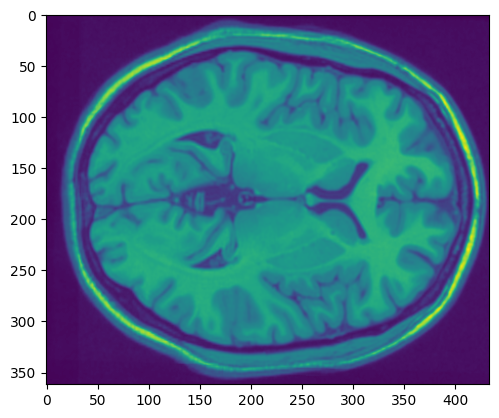

In [4]:
data = loadmat('Brain.mat')
T1 = data['T1']
label = data['label']

plt.imshow(T1[:, :, 0])

In [9]:
def evaluate_segmentation(segmented_image, ground_truth):
    # Calculate evaluation metrics
    # Example: Dice coefficient
    intersection = np.logical_and(segmented_image, ground_truth)
    dice_coefficient = 2.0 * intersection.sum() / (segmented_image.sum() + ground_truth.sum())
    return dice_coefficient

def eval_matrix(segmented_image, label_img):
    # Assuming seg_result and ground_truth are arrays representing the segmented results and ground truth labels, respectively

    # Calculate True Positives (TP), False Positives (FP), and False Negatives (FN)
    TP = np.sum(segmented_image & label_img)
    FP = np.sum(segmented_image & (~label_img))
    FN = np.sum((~segmented_image) & label_img)
    TN = np.sum((~segmented_image) & label_img)

    # Calculate Dice coefficient
    dice_coefficient = 2 * TP / (2 * TP + FP + FN)

    # Calculate Jaccard index
    jaccard_index = TP / (TP + FP + FN)

    # Calculate pixel accuracy
    pixel_accuracy = (TP + TN) / (TP + FP + TN + FN)

    # Print the calculated metrics
    print("Dice coefficient:", dice_coefficient)
    print("Jaccard index:", jaccard_index)
    print("Pixel accuracy:", pixel_accuracy)

def show_compared_images(t1_image, label_image, segmented_image, text):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    # Plot Original T1 Image
    img1 = ax1.imshow(t1_image)
    fig.colorbar(img1, ax=ax1, location='bottom',pad=0.01)
    ax1.set_title('Original T1 Image', fontsize=15)
    ax1.axis('off')

    # Plot Label Image with Colorbar
    img2 = ax2.imshow(label_image)
    fig.colorbar(img2, ax=ax2, location='bottom',pad=0.01)
    ax2.set_title('Label Image', fontsize=15)
    ax2.axis('off')

    # Plot Segmented Image
    img3 = ax3.imshow(segmented_image)
    fig.colorbar(img3, ax=ax3, location='bottom', pad=0.01)
    #text = str(n_cluster)
    ax3.set_title(text, fontsize=15)
    ax3.axis('off')

    plt.show()



In [10]:
# Cluserting Based: K-Mean segmentation
def kmeans_segmentation(image, n_clusters=5):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    reshaped_image = np.reshape(image, (-1, 1))

    #X_normalised = (reshaped_image - np.mean(reshaped_image))/np.std(reshaped_image)
    #print(image)
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, max_iter = 50, n_init=10).fit(reshaped_image)
    segmented_image = np.reshape(kmeans.labels_, image.shape)
    return segmented_image

def process_images_k_mean(n_cluster):
    for i in range(10):
        segmented_image = kmeans_segmentation(T1[:,:,i], n_cluster)
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'K-Mean ' + str(n_cluster )+ ' Cluster')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(segmented_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

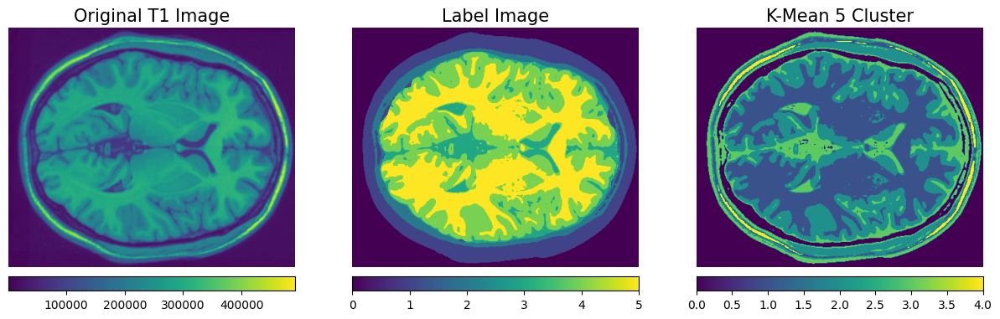

Level  0 Image
Dice coefficient: 0.25771737194287886
Jaccard index: 0.14791938333809151
Pixel accuracy: 0.47295776832534914


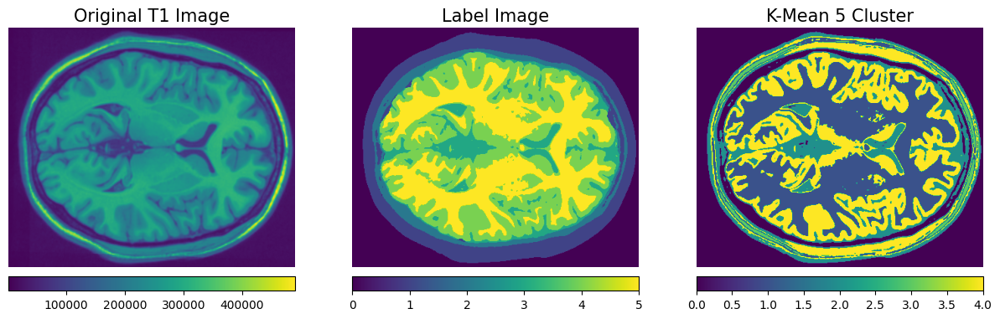

Level  1 Image
Dice coefficient: 0.5921082911559277
Jaccard index: 0.420563802909294
Pixel accuracy: 0.5953618885057141


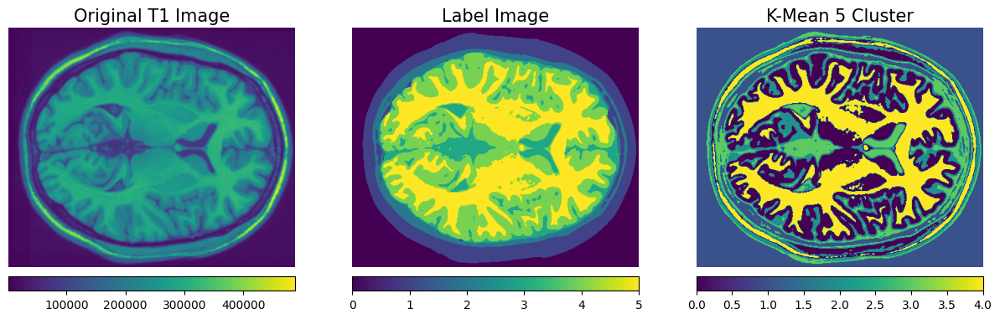

Level  2 Image
Dice coefficient: 0.4522818535766089
Jaccard index: 0.2922249471725735
Pixel accuracy: 0.5217776166200968


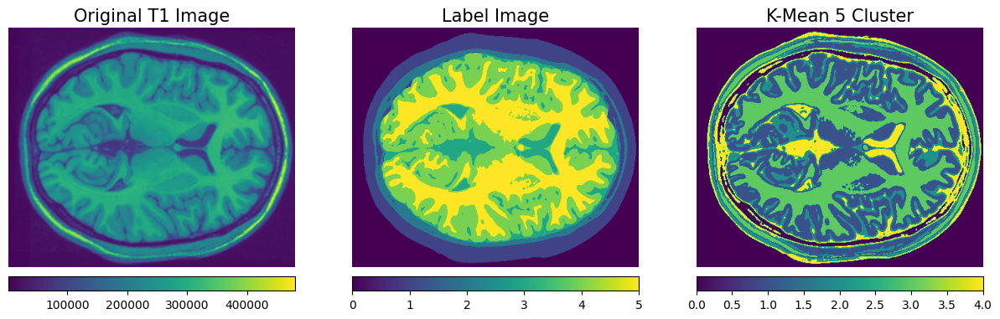

Level  3 Image
Dice coefficient: 0.15953759424116545
Jaccard index: 0.08668343006734065
Pixel accuracy: 0.4237139494523479


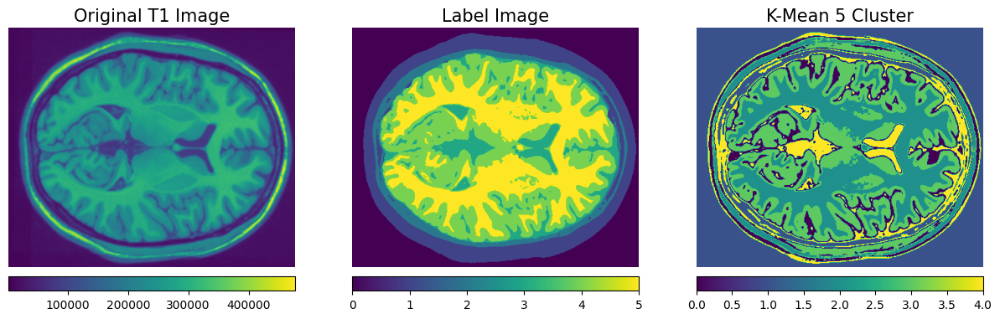

Level  4 Image
Dice coefficient: 0.030101452400142968
Jaccard index: 0.01528071201271703
Pixel accuracy: 0.3672616496523182


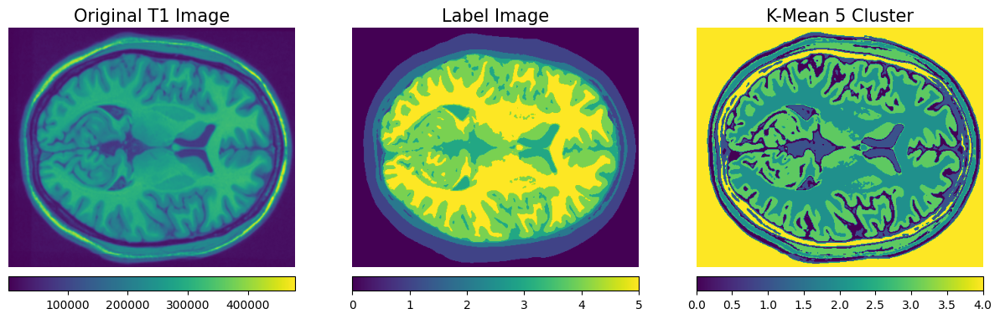

Level  5 Image
Dice coefficient: 0.054313866248229155
Jaccard index: 0.027915019440210742
Pixel accuracy: 0.3431337248194804


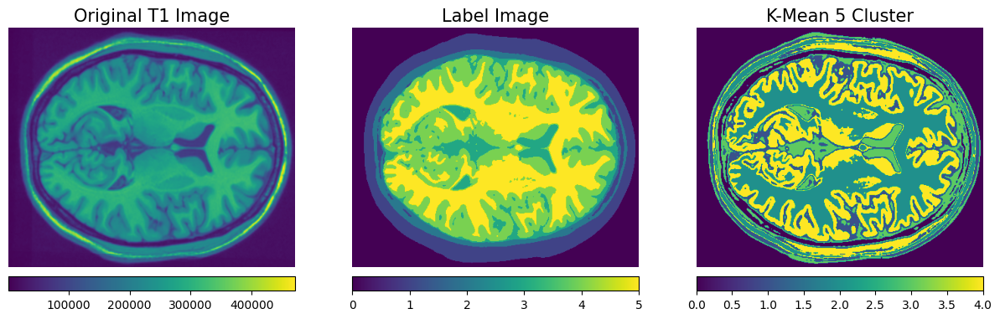

Level  6 Image
Dice coefficient: 0.5083813765503964
Jaccard index: 0.3408253078623303
Pixel accuracy: 0.5376914538171732


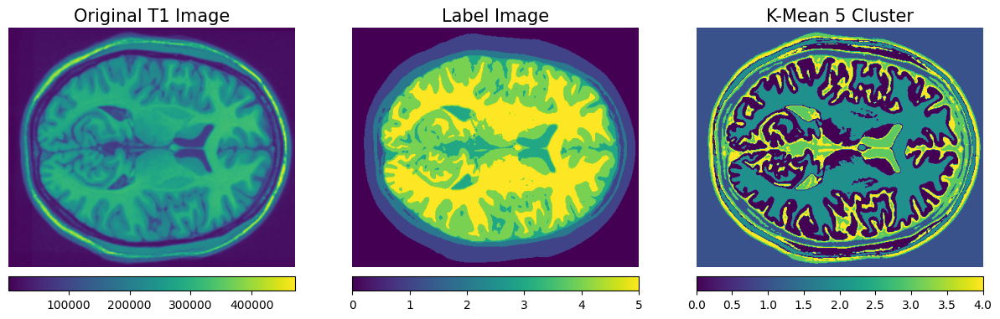

Level  7 Image
Dice coefficient: 0.20456689218629548
Jaccard index: 0.11393735099125815
Pixel accuracy: 0.4374779903744571


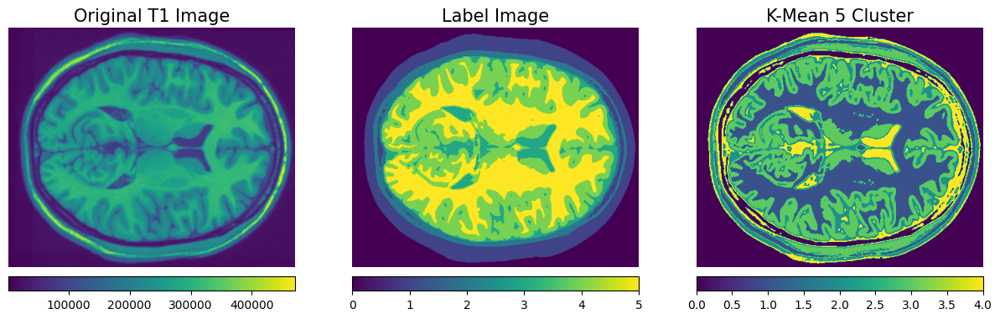

Level  8 Image
Dice coefficient: 0.16311737377953014
Jaccard index: 0.08880119581464872
Pixel accuracy: 0.4207979064186511


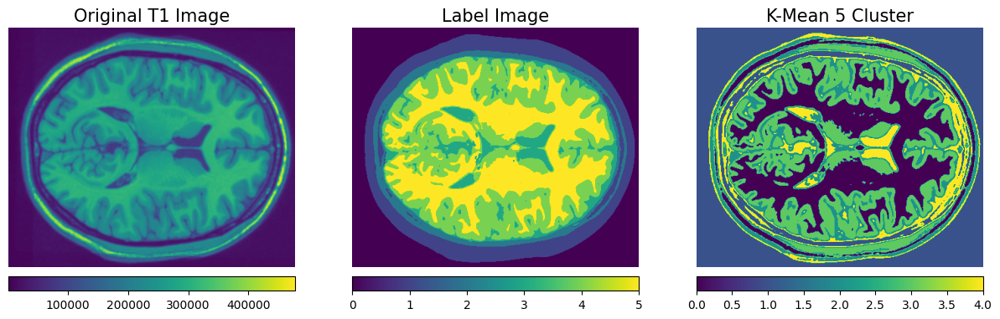

Level  9 Image
Dice coefficient: 0.05403124980753715
Jaccard index: 0.027765733546437105
Pixel accuracy: 0.38658397049455956


In [46]:
process_images_k_mean(5)

In [11]:
#threshold based: Otsu Method
def otsu_segmentation(image):
    threshold_value = threshold_otsu(image)
    segmented_image = image > threshold_value
    return segmented_image

def process_images_otsu():
    for i in range(10):
        segmented_image = otsu_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'Otsu Method')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(segmented_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))


In [ ]:
process_images_otsu()

In [26]:
def adaptive_gaussian_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')
    thresholded_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    return thresholded_image

def process_images_adaptive_gaussian():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Adaptive Gaussian Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))


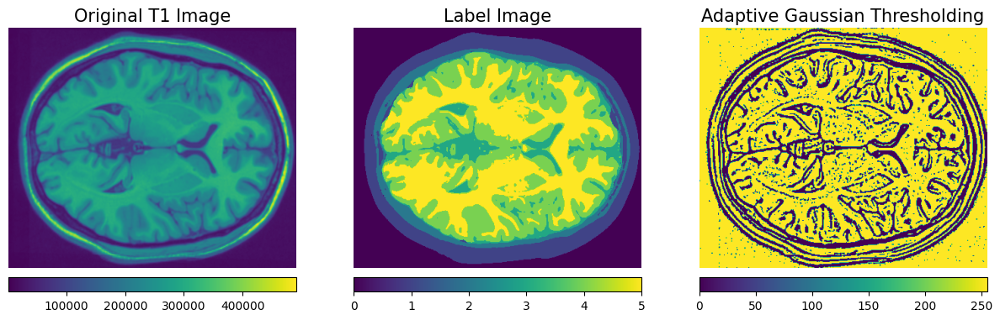

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


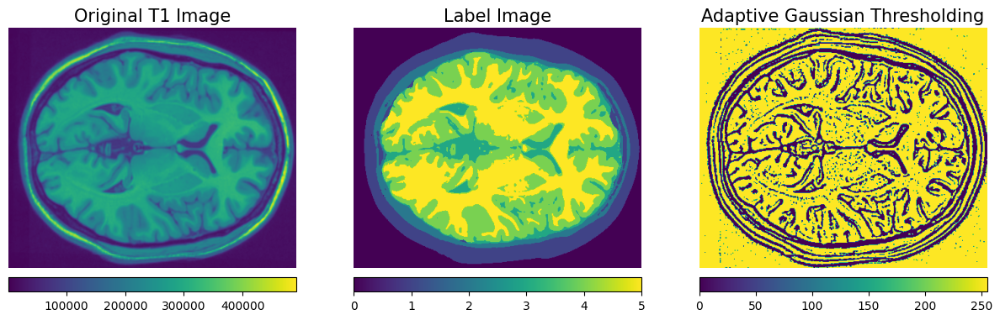

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


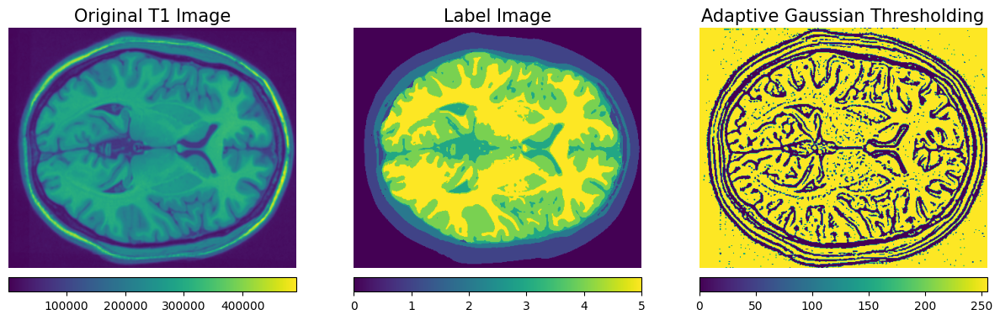

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


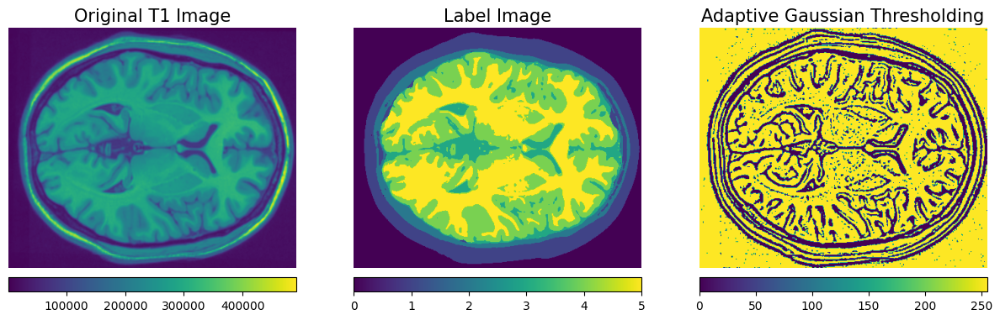

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


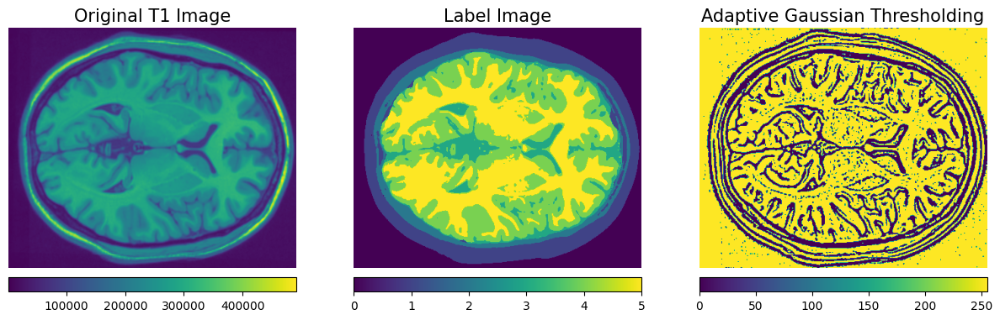

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


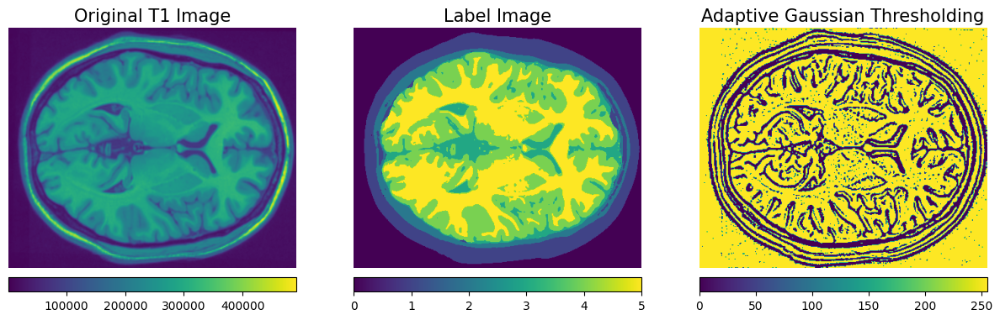

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


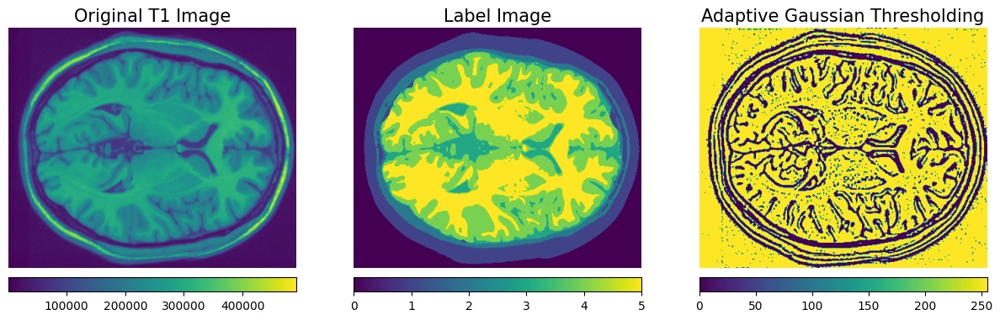

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


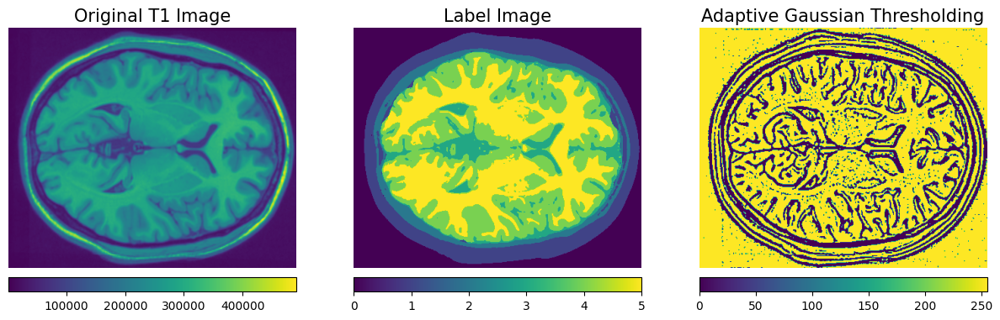

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


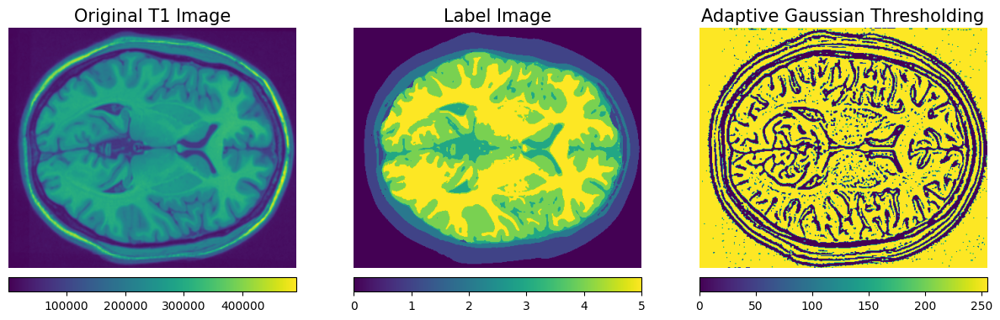

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


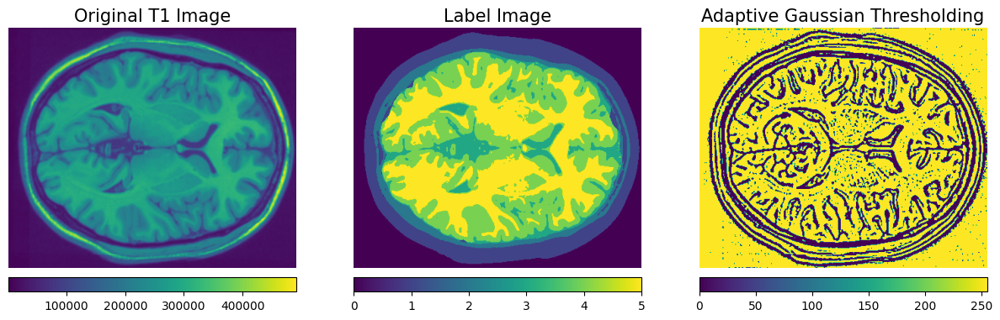

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [27]:
process_images_adaptive_gaussian()

In [28]:
def adaptive_mean_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')
    thresholded_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    return thresholded_image

def process_images_adaptive_mean():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Adaptive Mean Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

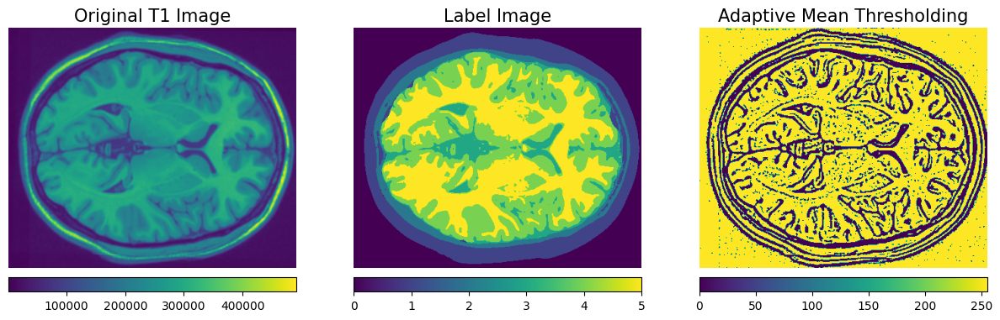

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


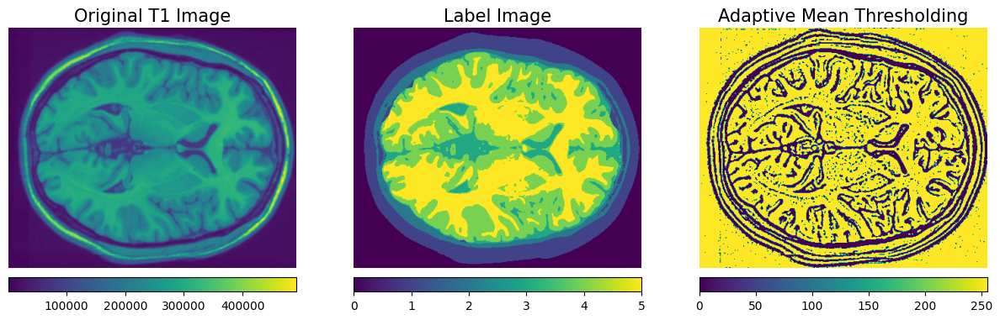

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


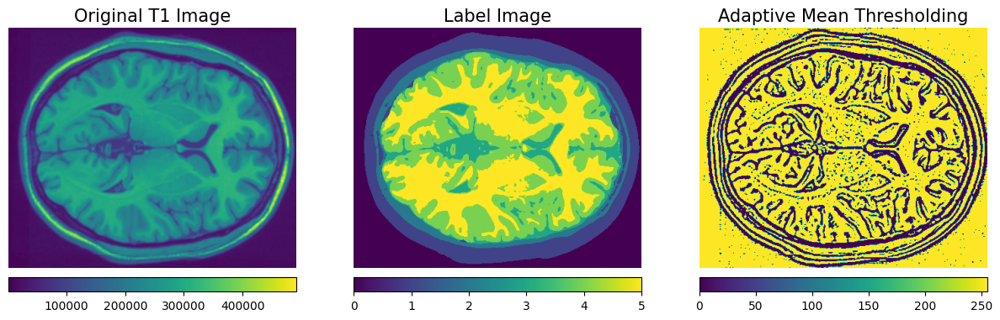

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


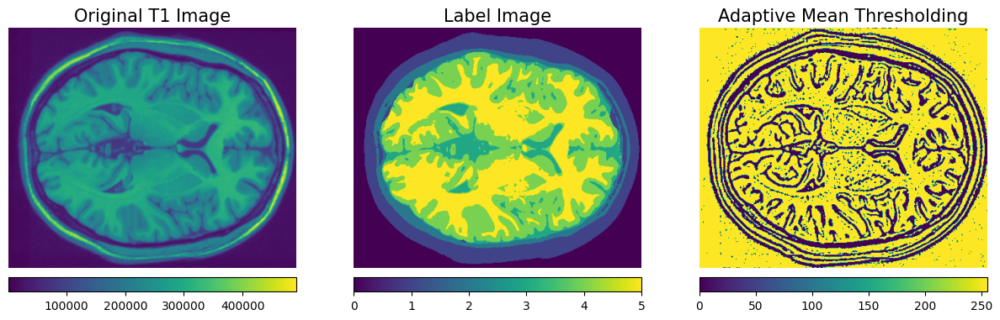

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


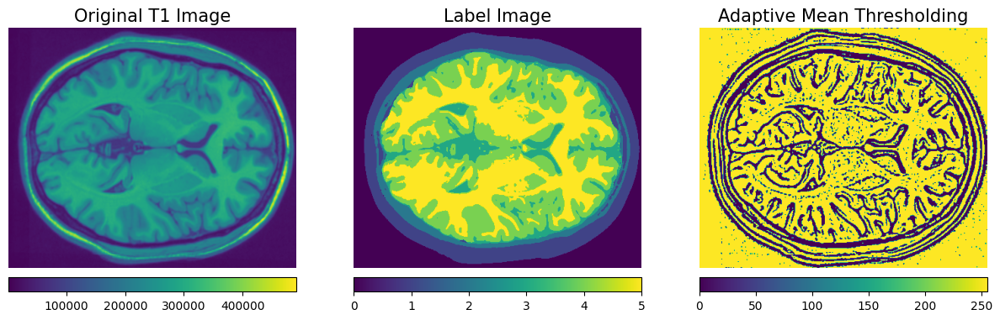

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


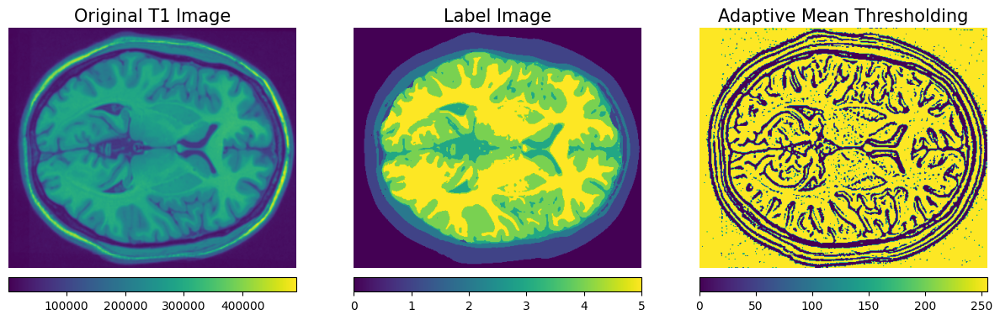

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


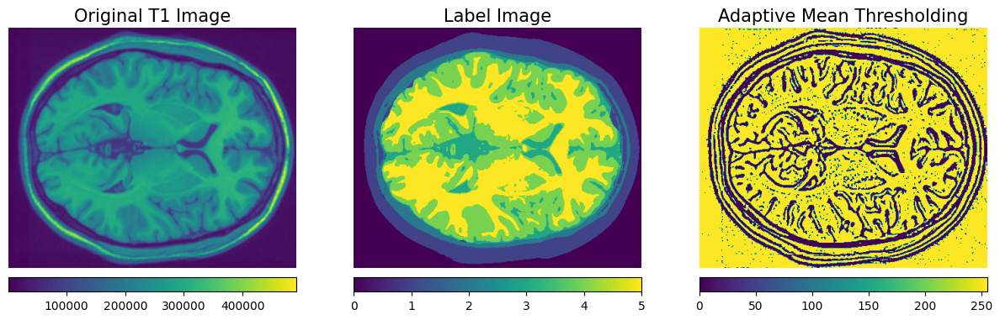

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


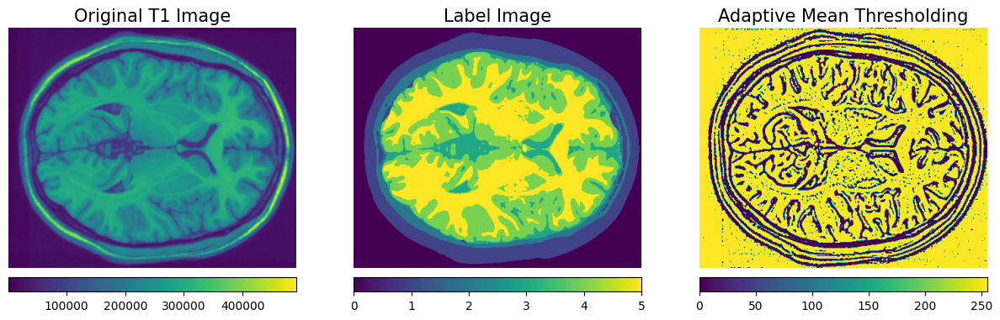

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


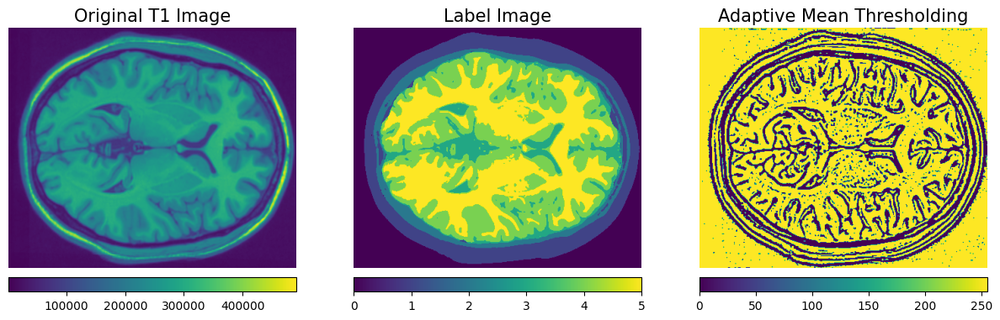

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


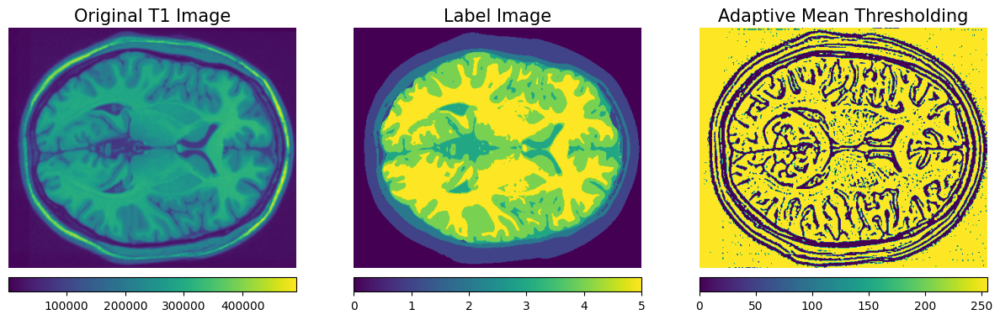

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [29]:

process_images_adaptive_mean()

In [32]:
def mean_shift_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')

    image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    segmented_image = cv2.pyrMeanShiftFiltering(image, 10, 20)

    return segmented_image

def process_images_mean_shift_segmentation():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Mean Shift Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

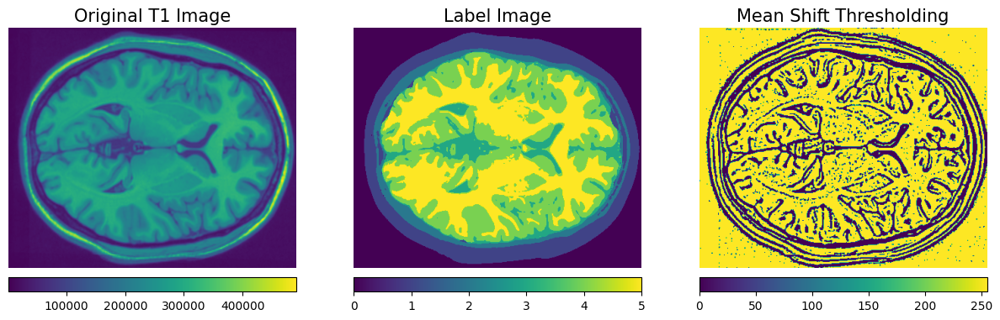

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


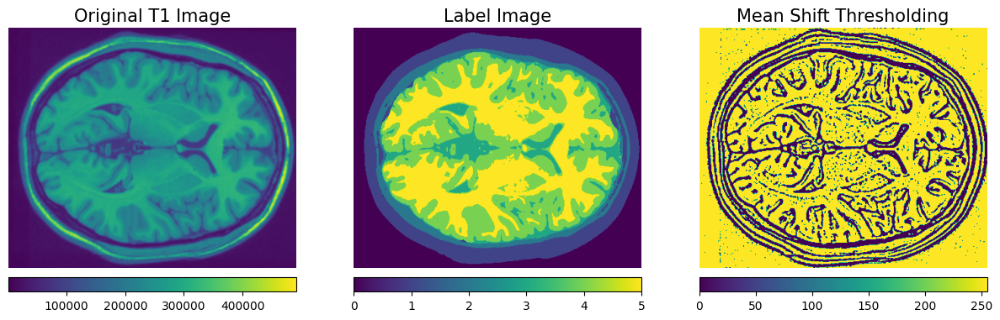

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


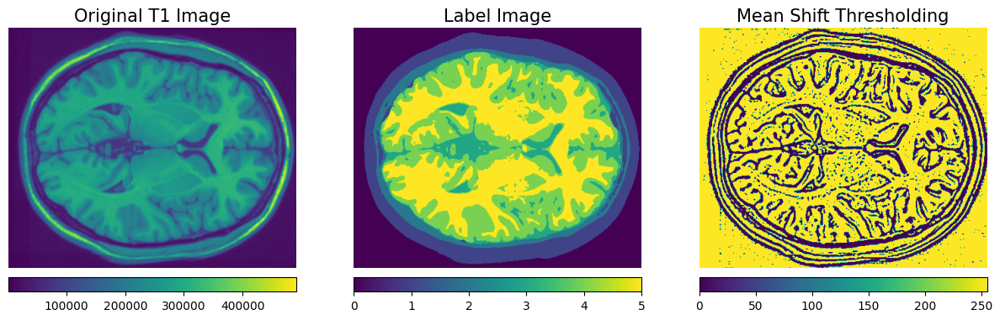

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


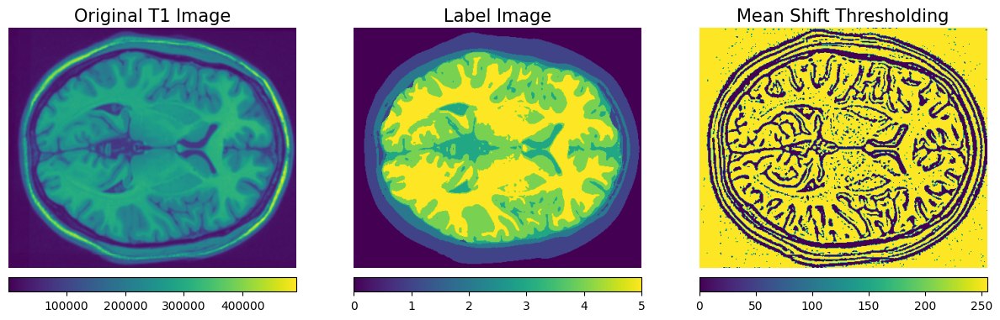

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


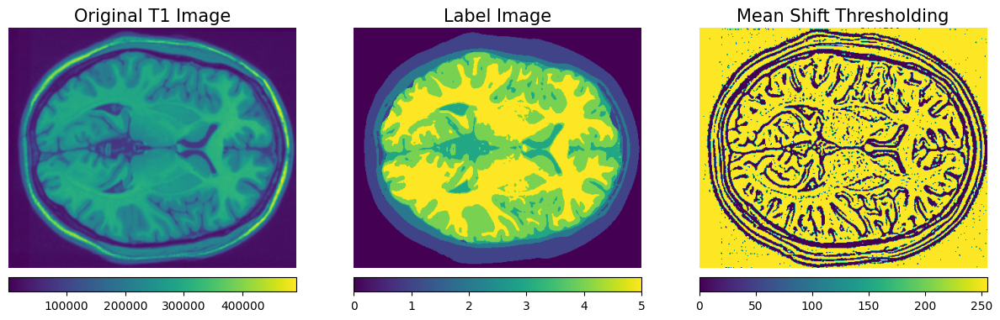

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


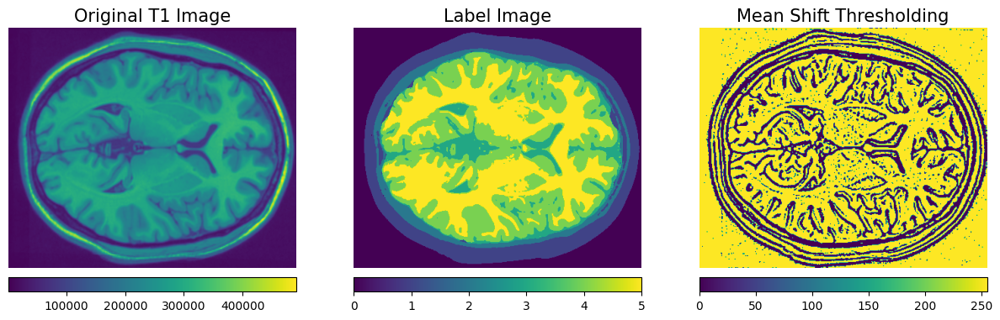

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


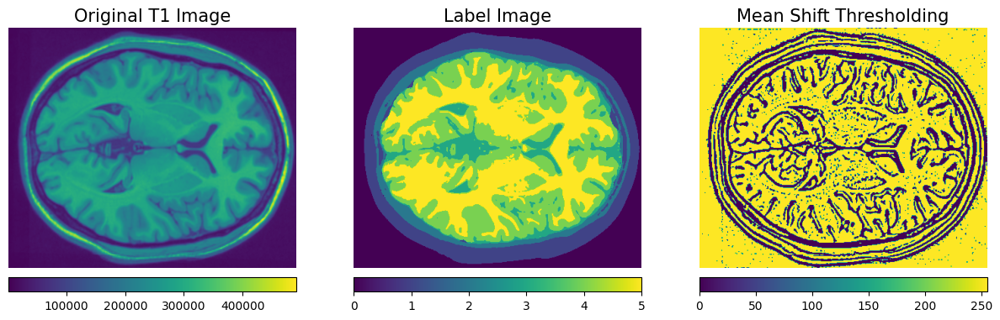

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


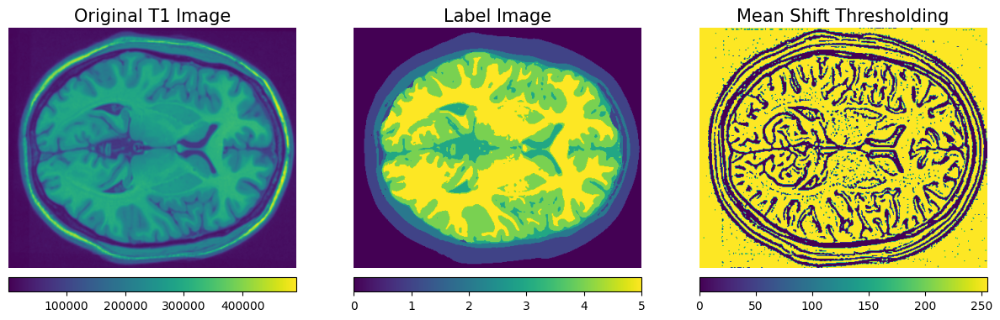

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


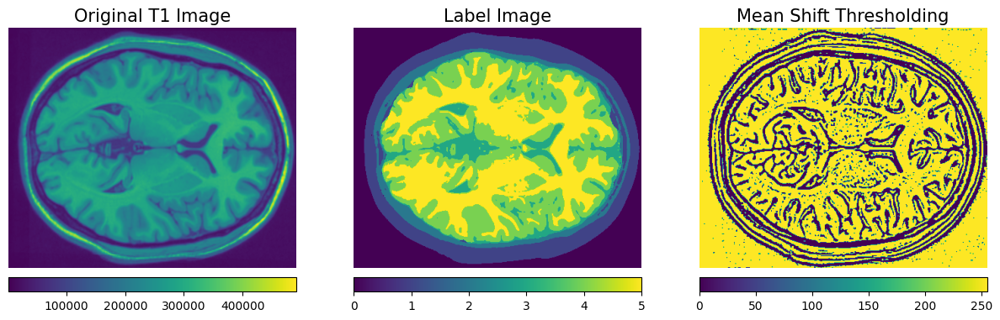

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


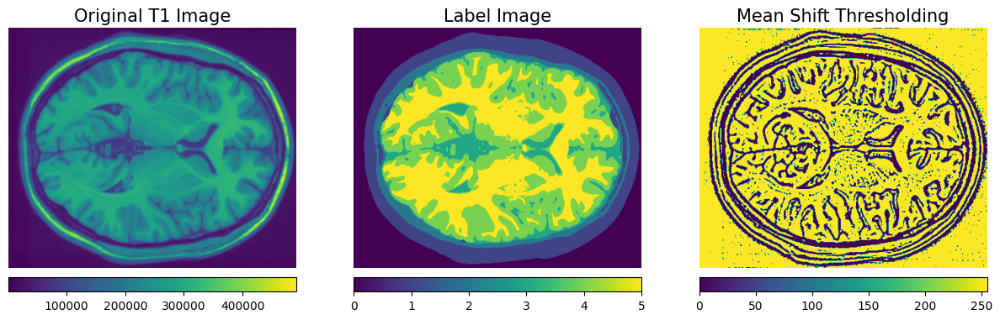

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [33]:
process_images_mean_shift_segmentation()

In [43]:


def region_growing(image, seed_point, threshold):
    image =  cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    # Create a mask and initialize it with zeros
    mask = np.zeros_like(image, dtype=np.uint8)

    # Define the region growing criteria
    connectivity = 4  # 4-connected neighborhood
    new_value = 255   # Set the intensity value for the segmented region

    # Create a list to store the seed points
    seed_points = [seed_point]

    # Iterate over the seed points until the list is empty
    while seed_points:
        # Pop the first seed point from the list
        current_point = seed_points.pop(0)

        # Check if the current point is within the image bounds
        if (0 <= current_point[0] < image.shape[0]) and (0 <= current_point[1] < image.shape[1]):
            # Check if the current pixel is not already segmented
            if mask[current_point] == 0:
                # Check the intensity difference between the current pixel and the seed pixel
                if abs(int(image[current_point]) - int(image[seed_point])) < threshold:
                    # Add the current pixel to the segmented region
                    mask[current_point] = new_value

                    # Add the neighboring pixels to the seed points list
                    seed_points.append((current_point[0] + 1, current_point[1]))
                    seed_points.append((current_point[0] - 1, current_point[1]))
                    seed_points.append((current_point[0], current_point[1] + 1))
                    seed_points.append((current_point[0], current_point[1] - 1))

    return mask

def process_images_region_growing(s1, s2, thresh):
    seed_point = (s1, s2)
    threshold = thresh
    for i in range(10):
        # Perform region growing segmentation
        segmented_image = region_growing(T1[:,:,i], seed_point, threshold)
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'Region Growing Segmentation')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))




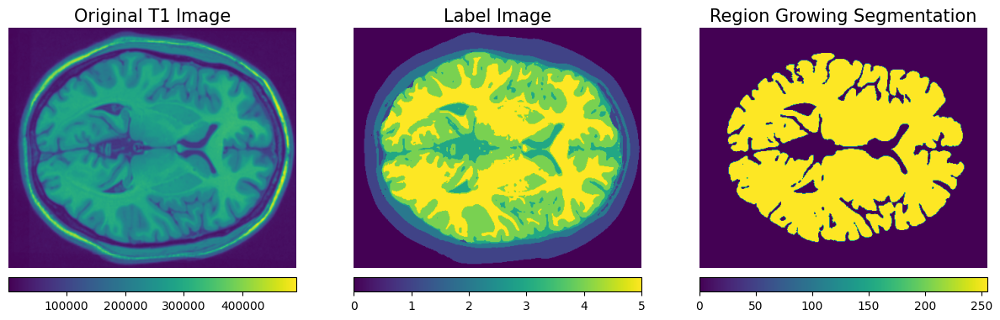

Level  0 Image
Dice coefficient: 0.01961088520385326
Jaccard index: 0.00990254140326959
Pixel accuracy: 0.014851501841558803


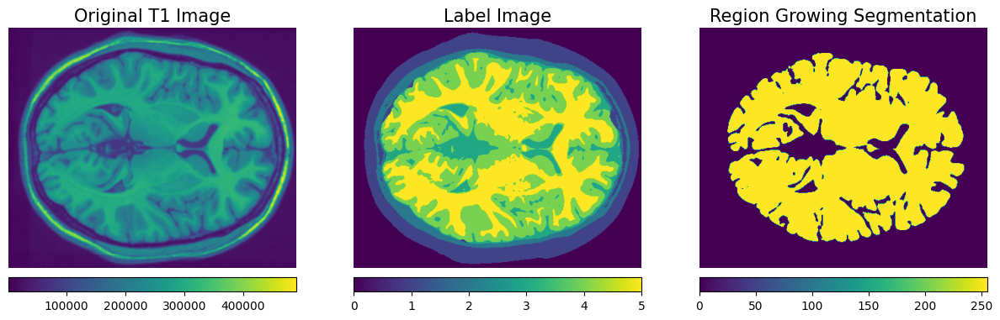

Level  1 Image
Dice coefficient: 0.019648510321767933
Jaccard index: 0.009921728755818204
Pixel accuracy: 0.014757457126804884


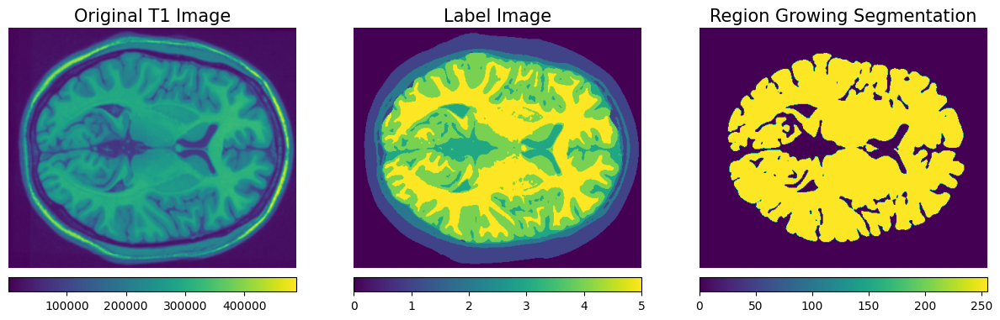

Level  2 Image
Dice coefficient: 0.019734991708002348
Jaccard index: 0.00996583367648556
Pixel accuracy: 0.014671695877111014


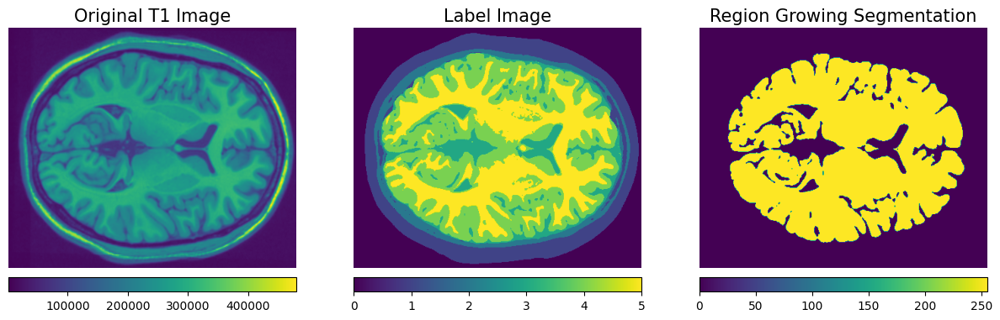

Level  3 Image
Dice coefficient: 0.019785770696505552
Jaccard index: 0.00999173241142947
Pixel accuracy: 0.014617914640514368


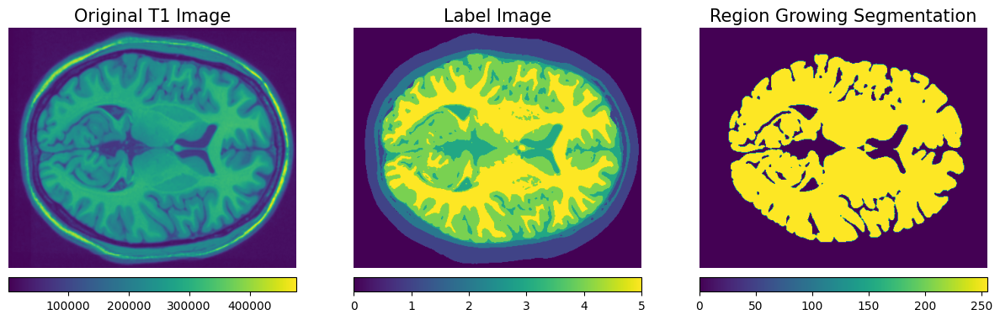

Level  4 Image
Dice coefficient: 0.01965430423123771
Jaccard index: 0.009924683489974202
Pixel accuracy: 0.014584639501958185


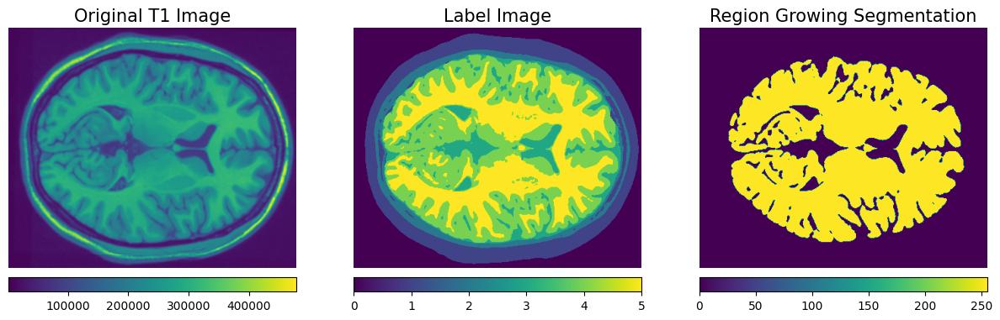

Level  5 Image
Dice coefficient: 0.019464262477454013
Jaccard index: 0.009827776448912695
Pixel accuracy: 0.014573482080596572


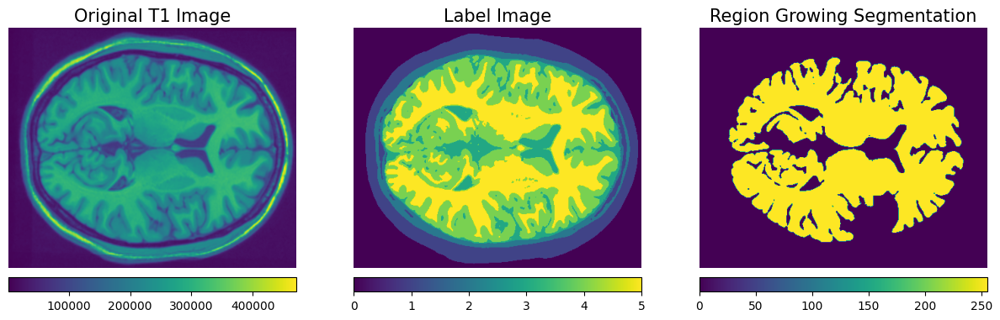

Level  6 Image
Dice coefficient: 0.01929099822911984
Jaccard index: 0.009739440882972945
Pixel accuracy: 0.0145589345261875


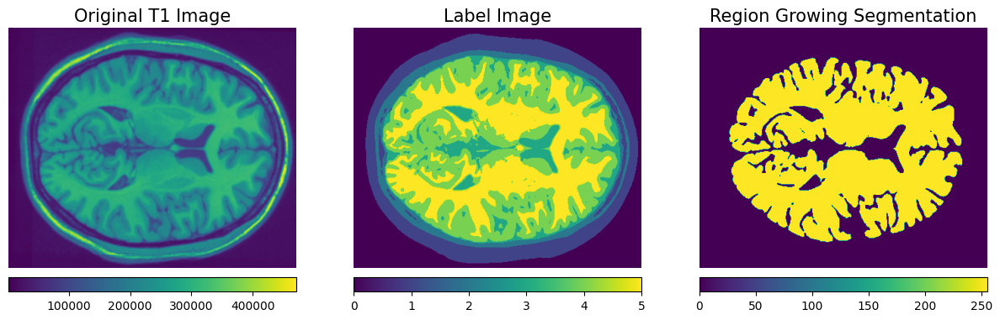

Level  7 Image
Dice coefficient: 0.01914595035918751
Jaccard index: 0.009665502797977085
Pixel accuracy: 0.014524568684820813


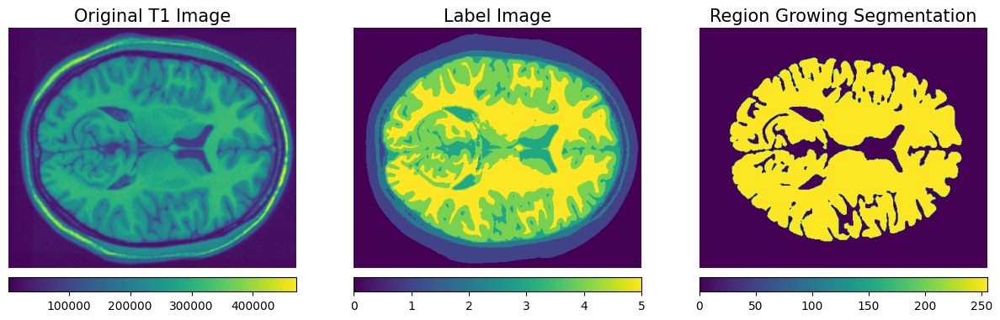

Level  8 Image
Dice coefficient: 0.019069619863424616
Jaccard index: 0.00962659771117744
Pixel accuracy: 0.014520616234663249


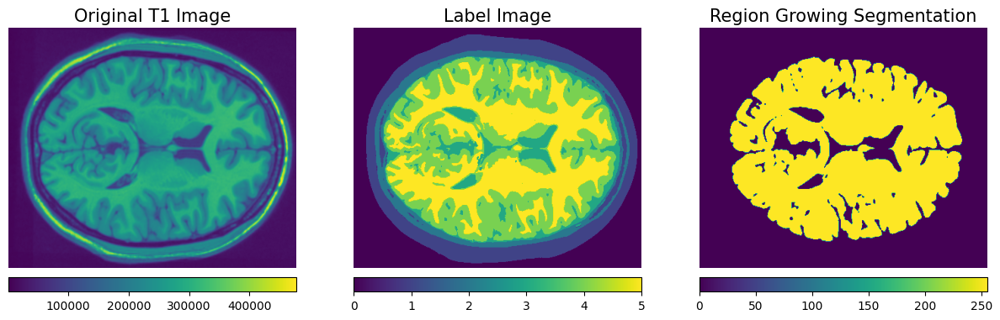

Level  9 Image
Dice coefficient: 0.018990627808103032
Jaccard index: 0.00958633920398406
Pixel accuracy: 0.014507709663258551


In [46]:
#seed , seed, threshold
process_images_region_growing(100, 100, 50)

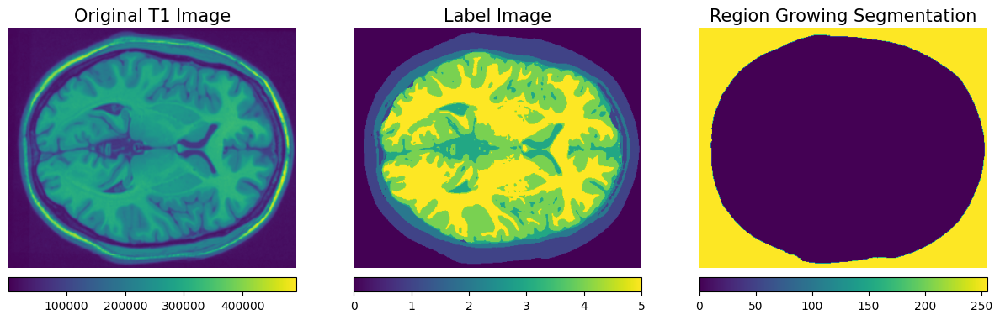

Level  0 Image
Dice coefficient: 0.01961088520385326
Jaccard index: 0.00990254140326959
Pixel accuracy: 0.014851501841558803


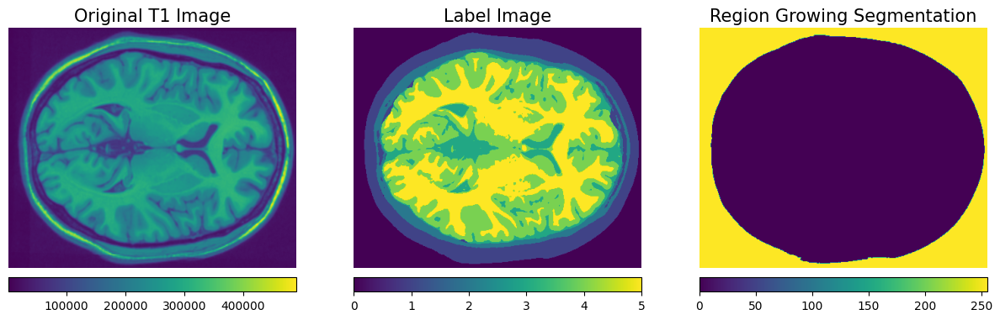

Level  1 Image
Dice coefficient: 0.019648510321767933
Jaccard index: 0.009921728755818204
Pixel accuracy: 0.014757457126804884


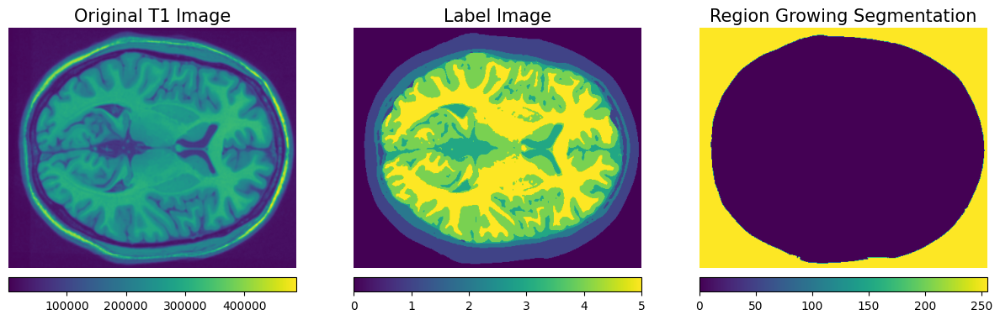

Level  2 Image
Dice coefficient: 0.019734991708002348
Jaccard index: 0.00996583367648556
Pixel accuracy: 0.014671695877111014


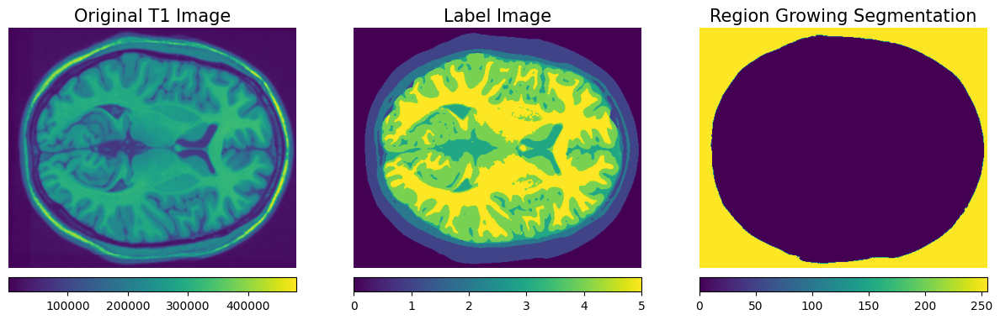

Level  3 Image
Dice coefficient: 0.019785770696505552
Jaccard index: 0.00999173241142947
Pixel accuracy: 0.014617914640514368


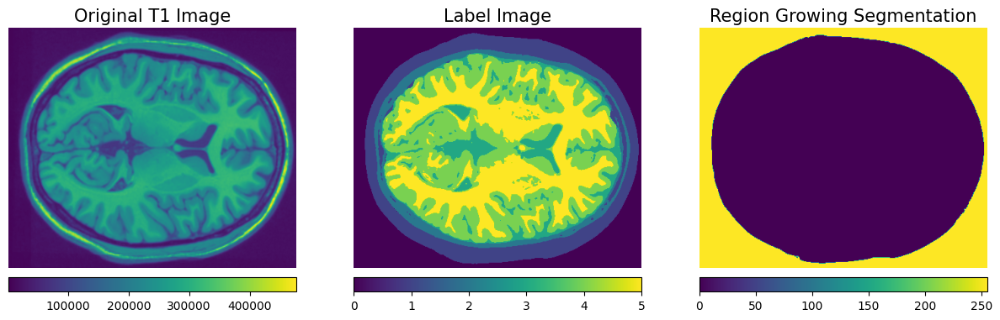

Level  4 Image
Dice coefficient: 0.01965430423123771
Jaccard index: 0.009924683489974202
Pixel accuracy: 0.014584639501958185


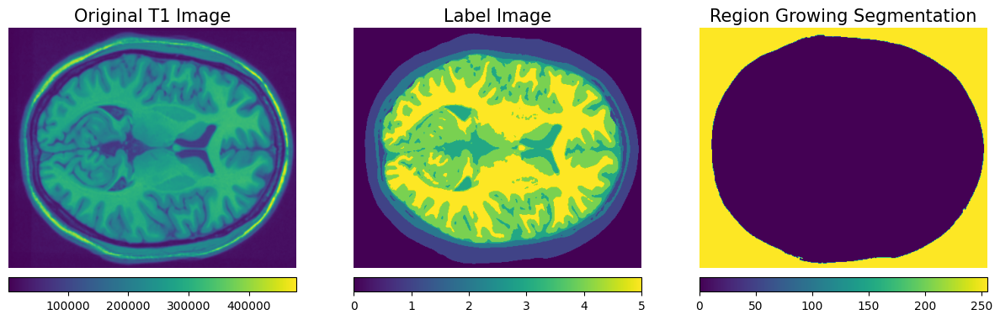

Level  5 Image
Dice coefficient: 0.019464262477454013
Jaccard index: 0.009827776448912695
Pixel accuracy: 0.014573482080596572


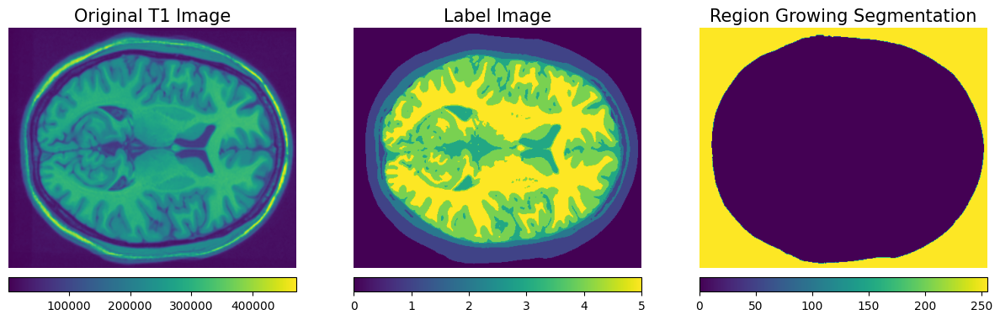

Level  6 Image
Dice coefficient: 0.01929099822911984
Jaccard index: 0.009739440882972945
Pixel accuracy: 0.0145589345261875


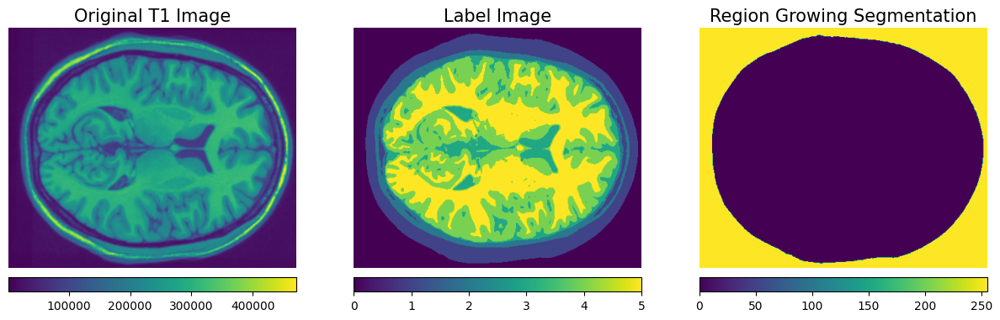

Level  7 Image
Dice coefficient: 0.01914595035918751
Jaccard index: 0.009665502797977085
Pixel accuracy: 0.014524568684820813


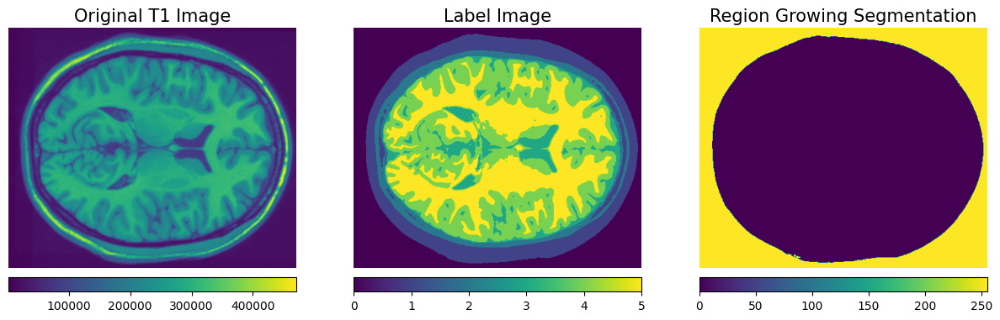

Level  8 Image
Dice coefficient: 0.019069619863424616
Jaccard index: 0.00962659771117744
Pixel accuracy: 0.014520616234663249


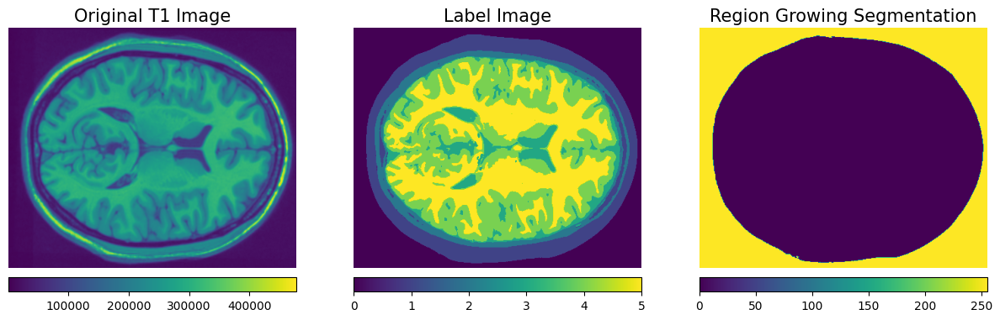

Level  9 Image
Dice coefficient: 0.018990627808103032
Jaccard index: 0.00958633920398406
Pixel accuracy: 0.014507709663258551


In [56]:
#seed , seed, threshold
process_images_region_growing(50, 50, 50)

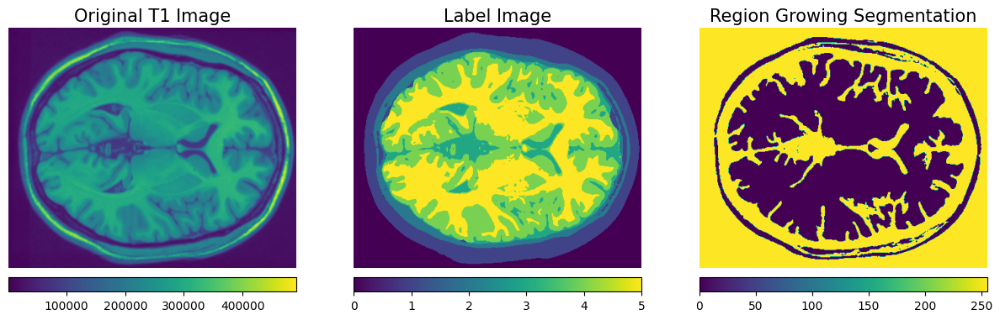

Level  0 Image
Dice coefficient: 0.01961088520385326
Jaccard index: 0.00990254140326959
Pixel accuracy: 0.014851501841558803


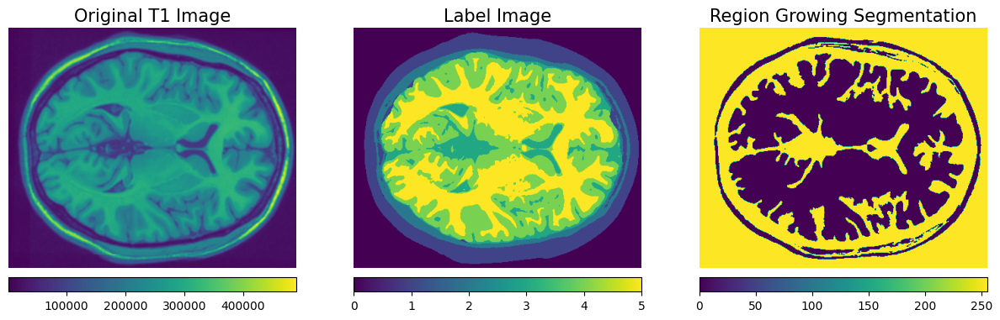

Level  1 Image
Dice coefficient: 0.019648510321767933
Jaccard index: 0.009921728755818204
Pixel accuracy: 0.014757457126804884


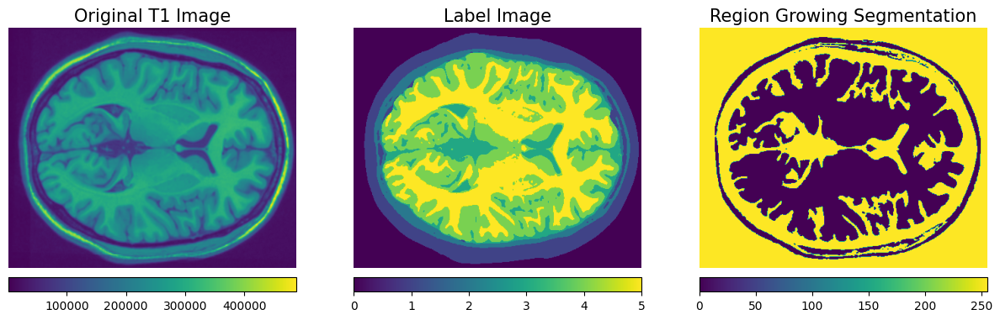

Level  2 Image
Dice coefficient: 0.019734991708002348
Jaccard index: 0.00996583367648556
Pixel accuracy: 0.014671695877111014


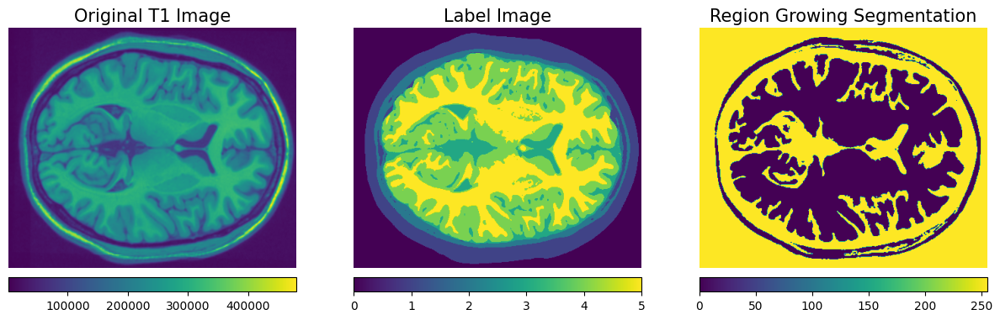

Level  3 Image
Dice coefficient: 0.019785770696505552
Jaccard index: 0.00999173241142947
Pixel accuracy: 0.014617914640514368


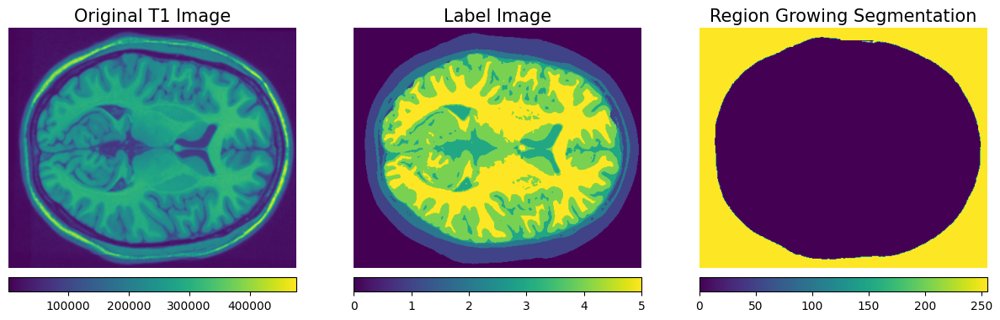

Level  4 Image
Dice coefficient: 0.01965430423123771
Jaccard index: 0.009924683489974202
Pixel accuracy: 0.014584639501958185


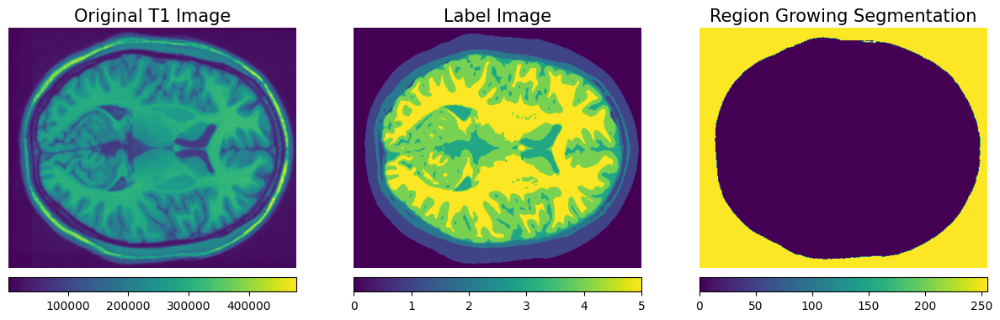

Level  5 Image
Dice coefficient: 0.019464262477454013
Jaccard index: 0.009827776448912695
Pixel accuracy: 0.014573482080596572


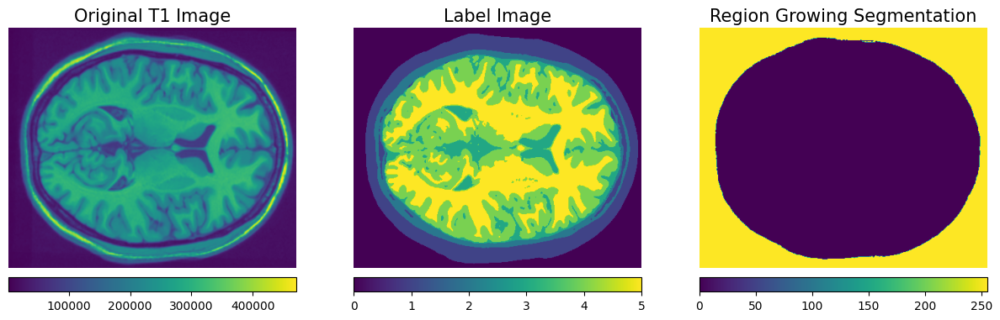

Level  6 Image
Dice coefficient: 0.01929099822911984
Jaccard index: 0.009739440882972945
Pixel accuracy: 0.0145589345261875


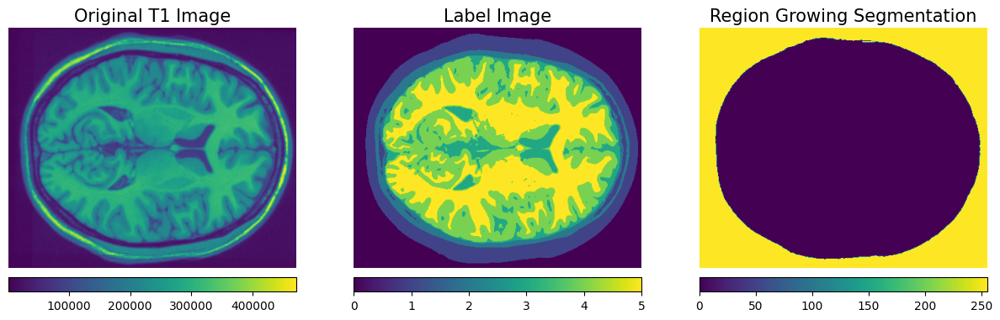

Level  7 Image
Dice coefficient: 0.01914595035918751
Jaccard index: 0.009665502797977085
Pixel accuracy: 0.014524568684820813


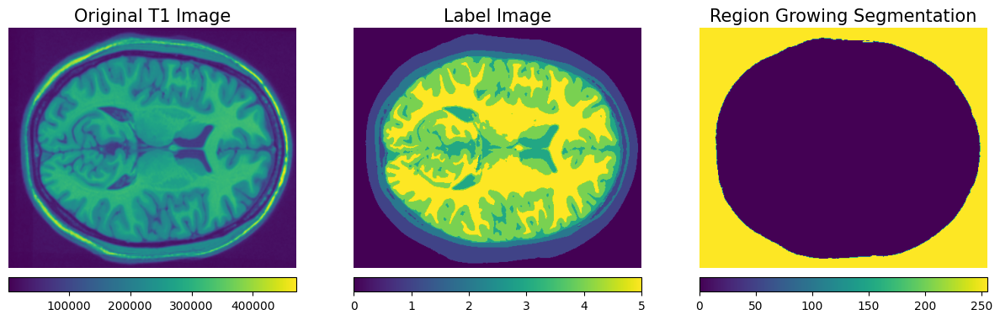

Level  8 Image
Dice coefficient: 0.019069619863424616
Jaccard index: 0.00962659771117744
Pixel accuracy: 0.014520616234663249


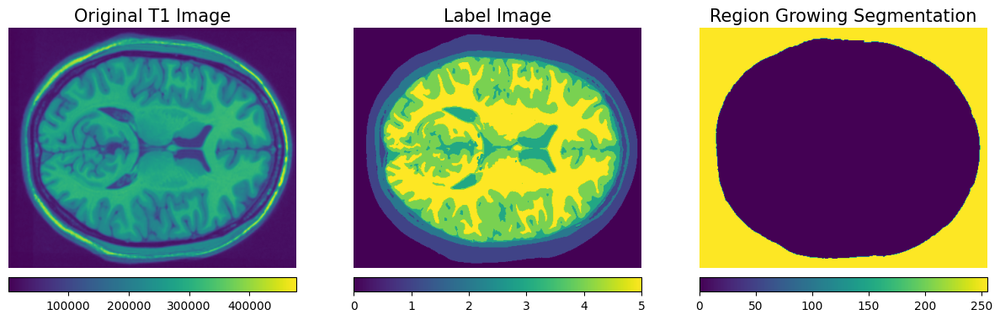

Level  9 Image
Dice coefficient: 0.018990627808103032
Jaccard index: 0.00958633920398406
Pixel accuracy: 0.014507709663258551


In [69]:
#seed , seed, threshold
process_images_region_growing(50, 50, 100)

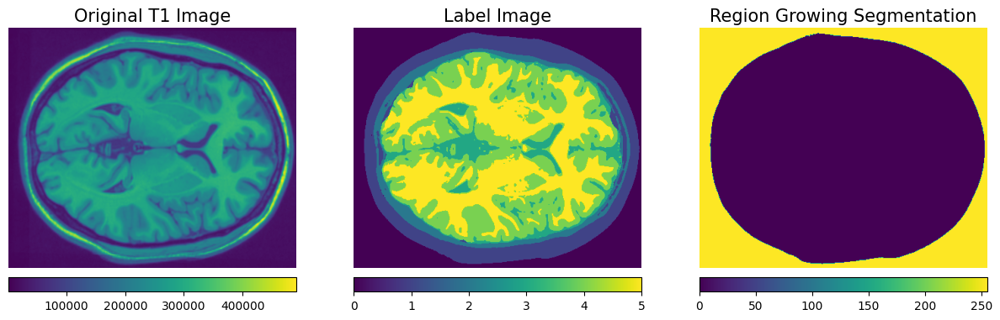

Level  0 Image
Dice coefficient: 0.01961088520385326
Jaccard index: 0.00990254140326959
Pixel accuracy: 0.014851501841558803


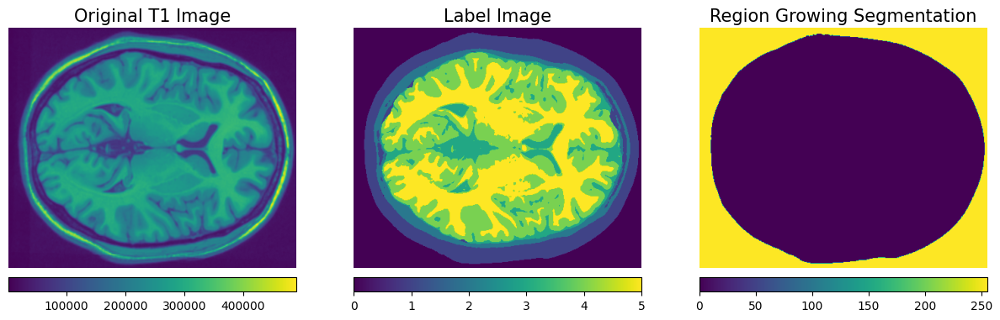

Level  1 Image
Dice coefficient: 0.019648510321767933
Jaccard index: 0.009921728755818204
Pixel accuracy: 0.014757457126804884


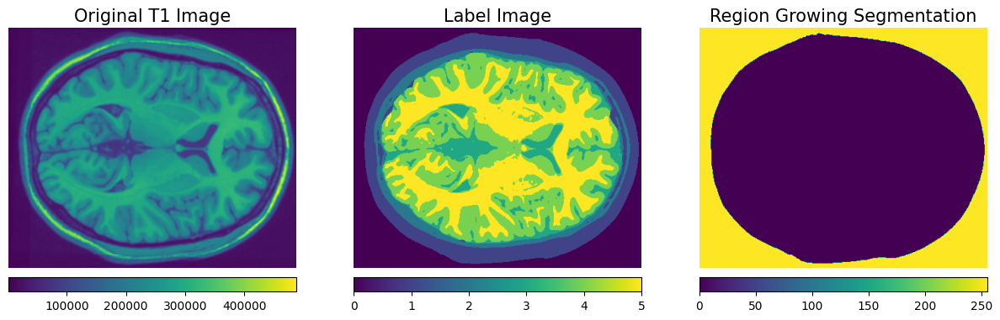

Level  2 Image
Dice coefficient: 0.019734991708002348
Jaccard index: 0.00996583367648556
Pixel accuracy: 0.014671695877111014


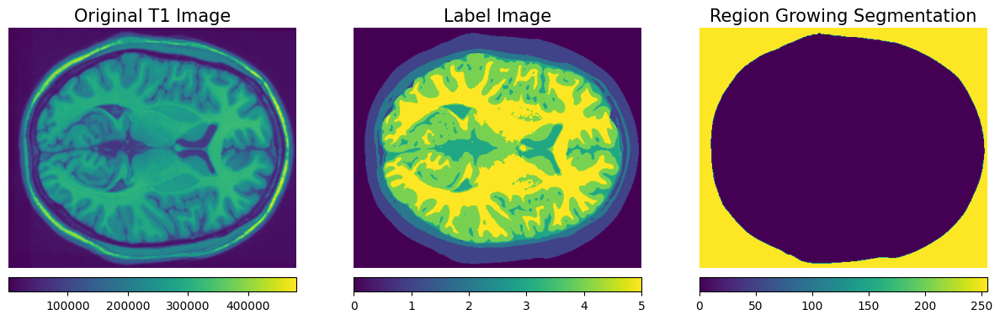

Level  3 Image
Dice coefficient: 0.019785770696505552
Jaccard index: 0.00999173241142947
Pixel accuracy: 0.014617914640514368


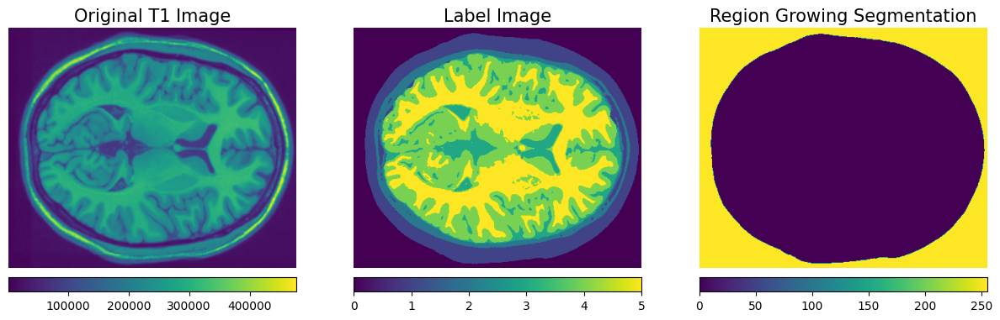

Level  4 Image
Dice coefficient: 0.01965430423123771
Jaccard index: 0.009924683489974202
Pixel accuracy: 0.014584639501958185


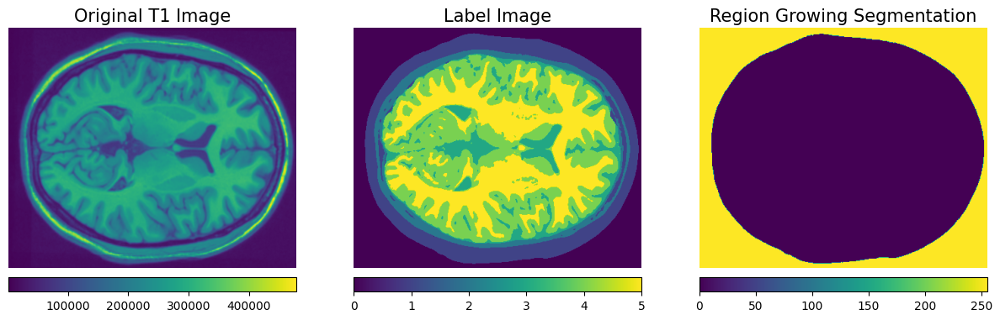

Level  5 Image
Dice coefficient: 0.019464262477454013
Jaccard index: 0.009827776448912695
Pixel accuracy: 0.014573482080596572


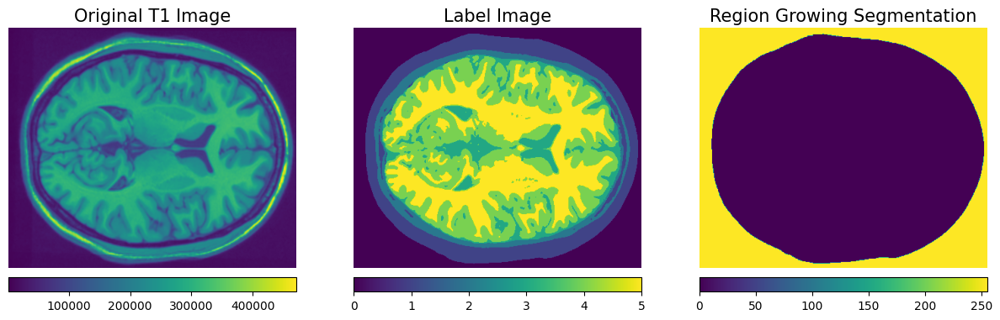

Level  6 Image
Dice coefficient: 0.01929099822911984
Jaccard index: 0.009739440882972945
Pixel accuracy: 0.0145589345261875


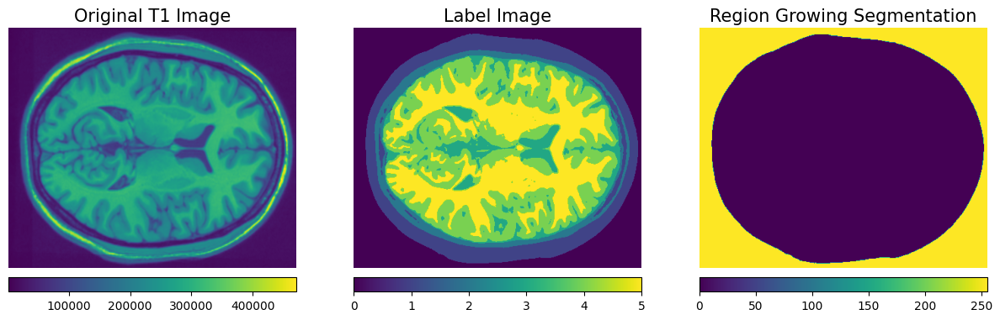

Level  7 Image
Dice coefficient: 0.01914595035918751
Jaccard index: 0.009665502797977085
Pixel accuracy: 0.014524568684820813


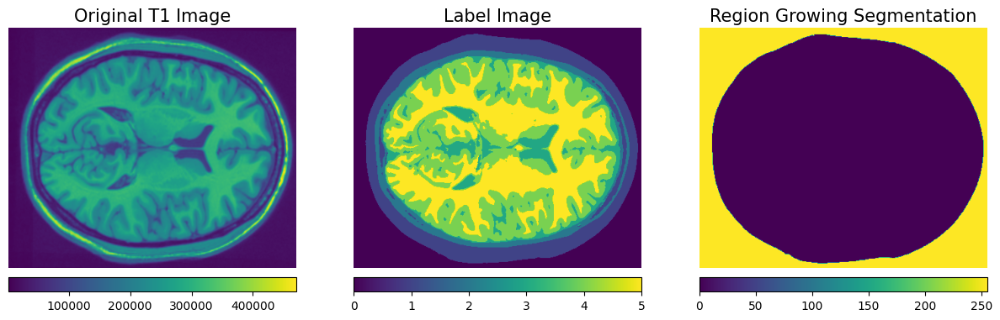

Level  8 Image
Dice coefficient: 0.019069619863424616
Jaccard index: 0.00962659771117744
Pixel accuracy: 0.014520616234663249


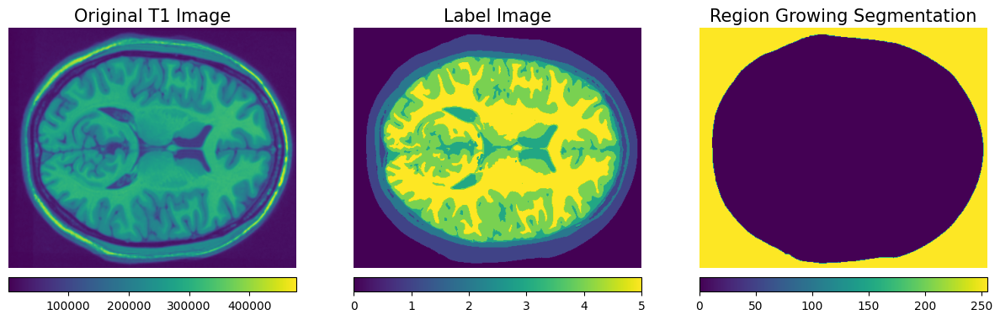

Level  9 Image
Dice coefficient: 0.018990627808103032
Jaccard index: 0.00958633920398406
Pixel accuracy: 0.014507709663258551


In [70]:
#seed , seed, threshold
process_images_region_growing(10, 10, 50)

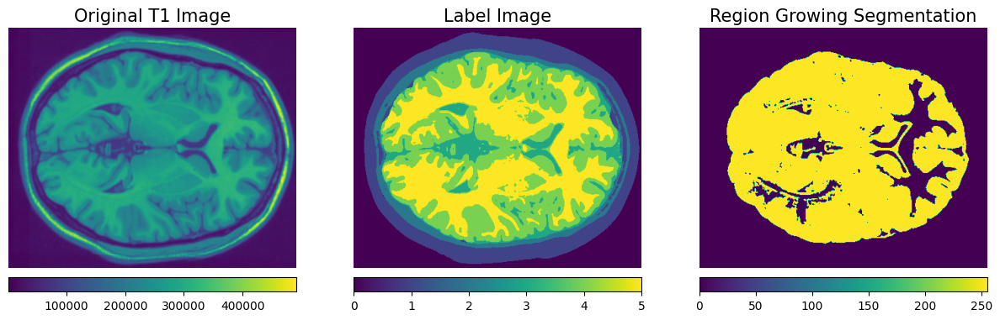

Level  0 Image
Dice coefficient: 0.01961088520385326
Jaccard index: 0.00990254140326959
Pixel accuracy: 0.014851501841558803


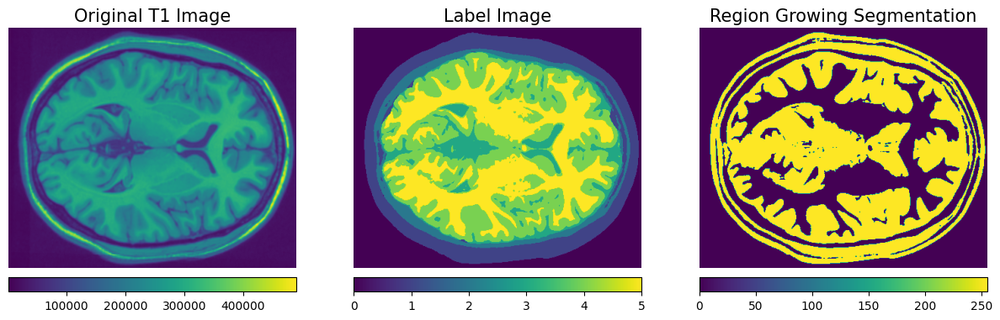

Level  1 Image
Dice coefficient: 0.019648510321767933
Jaccard index: 0.009921728755818204
Pixel accuracy: 0.014757457126804884


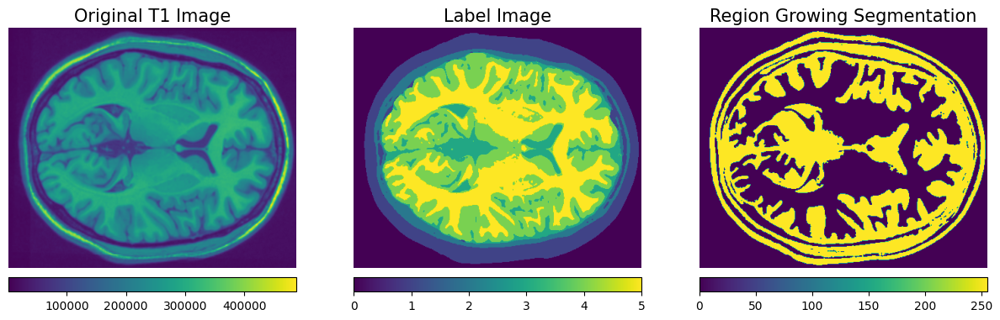

Level  2 Image
Dice coefficient: 0.019734991708002348
Jaccard index: 0.00996583367648556
Pixel accuracy: 0.014671695877111014


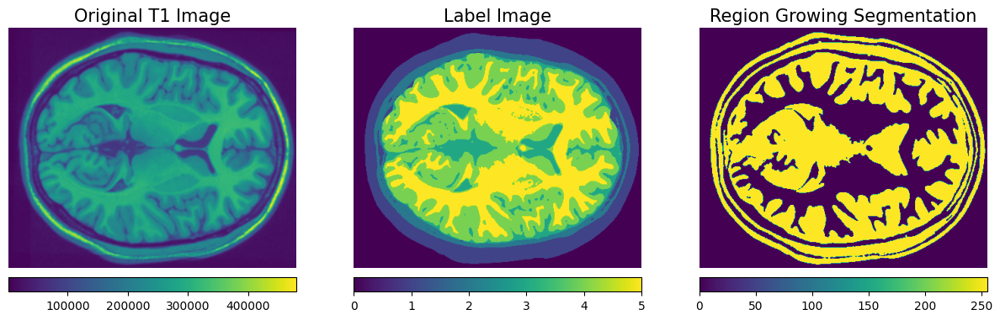

Level  3 Image
Dice coefficient: 0.019785770696505552
Jaccard index: 0.00999173241142947
Pixel accuracy: 0.014617914640514368


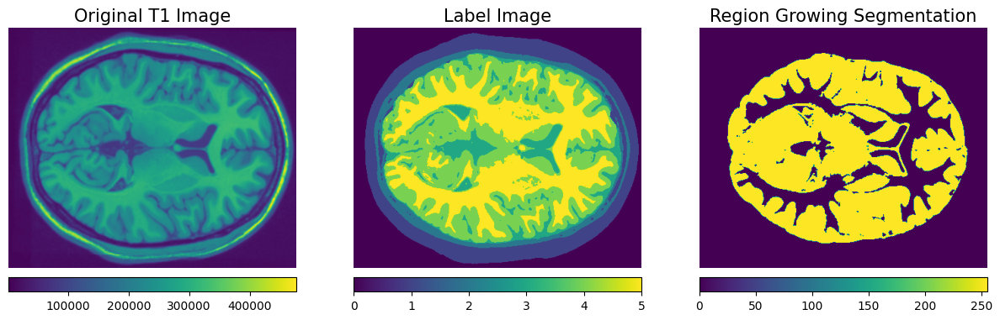

Level  4 Image
Dice coefficient: 0.01965430423123771
Jaccard index: 0.009924683489974202
Pixel accuracy: 0.014584639501958185


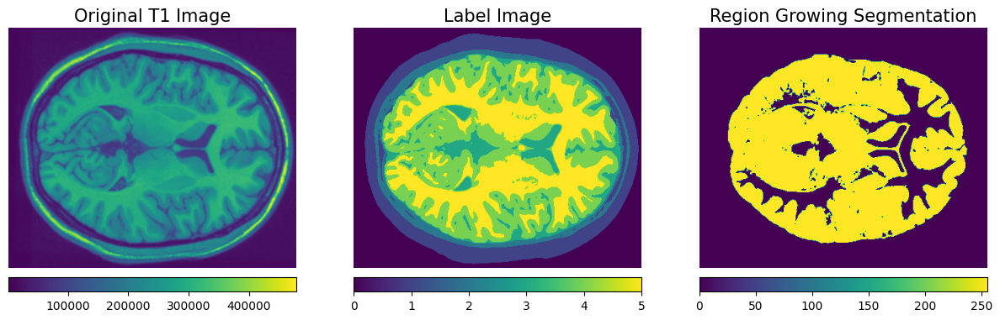

Level  5 Image
Dice coefficient: 0.019464262477454013
Jaccard index: 0.009827776448912695
Pixel accuracy: 0.014573482080596572


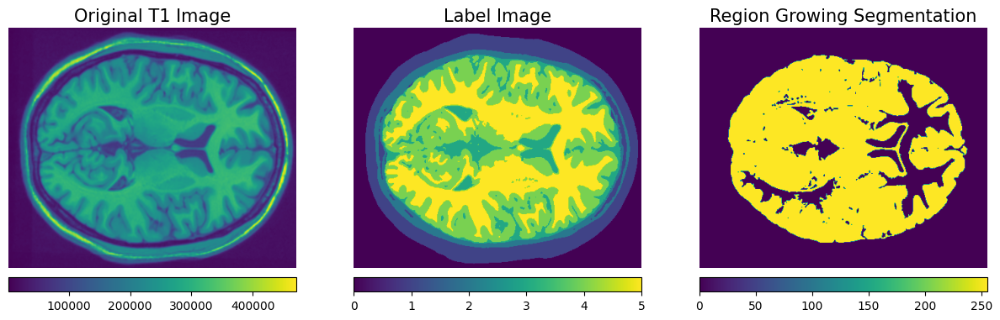

Level  6 Image
Dice coefficient: 0.01929099822911984
Jaccard index: 0.009739440882972945
Pixel accuracy: 0.0145589345261875


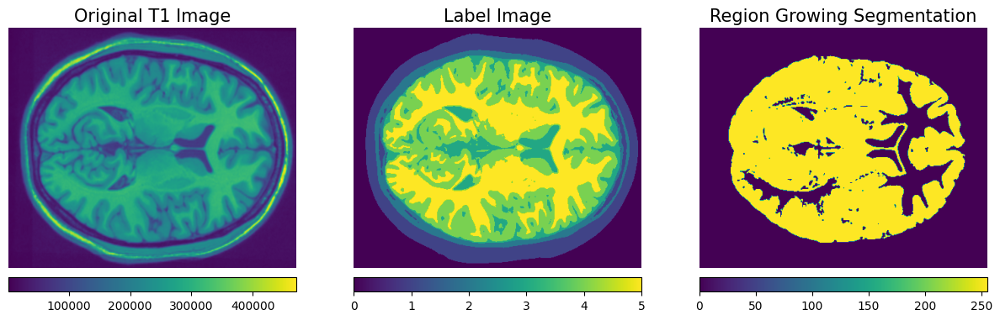

Level  7 Image
Dice coefficient: 0.01914595035918751
Jaccard index: 0.009665502797977085
Pixel accuracy: 0.014524568684820813


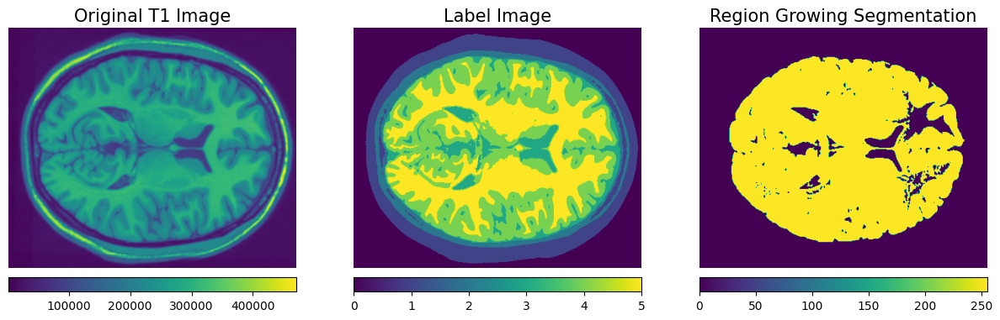

Level  8 Image
Dice coefficient: 0.019069619863424616
Jaccard index: 0.00962659771117744
Pixel accuracy: 0.014520616234663249


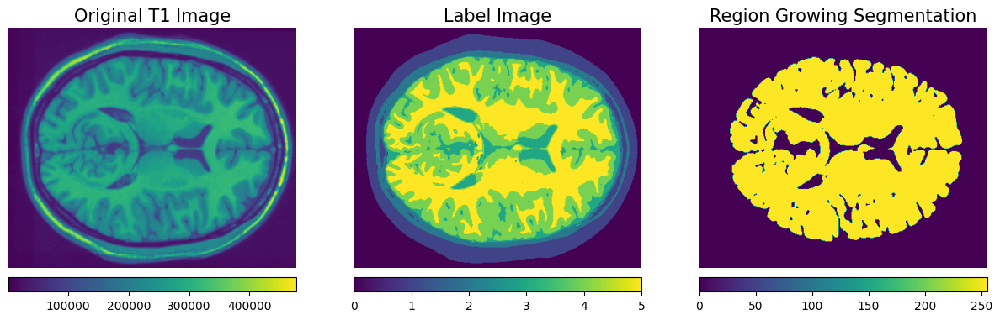

Level  9 Image
Dice coefficient: 0.018990627808103032
Jaccard index: 0.00958633920398406
Pixel accuracy: 0.014507709663258551


In [71]:
#seed , seed, threshold
process_images_region_growing(150, 150, 50)

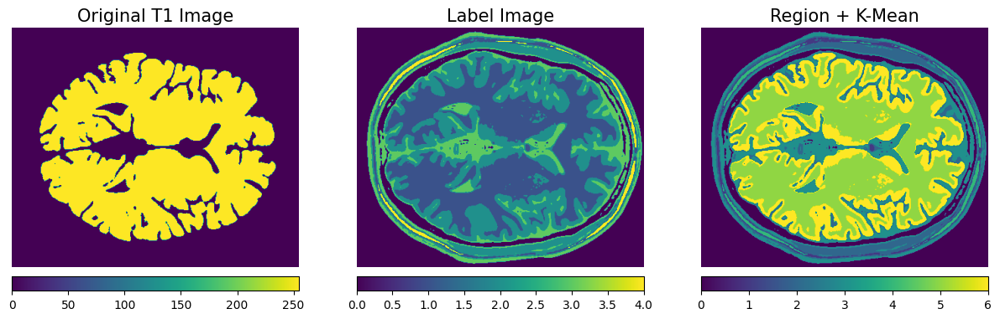

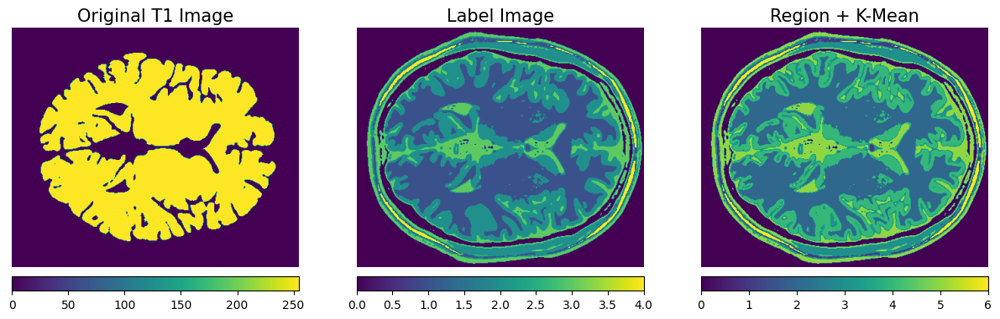

In [78]:
segmented_image1 = region_growing(T1[:,:,0], (100, 100), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)

# show_compared_images(label[:,:,0], segmented_image1, segmented_image2, 'Region + K-Mean')

# plt.imshow(join_segmentations(segmented_image1, segmented_image2))
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

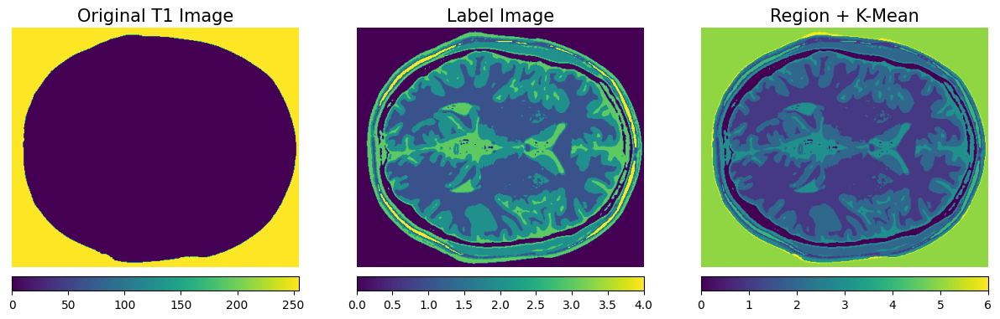

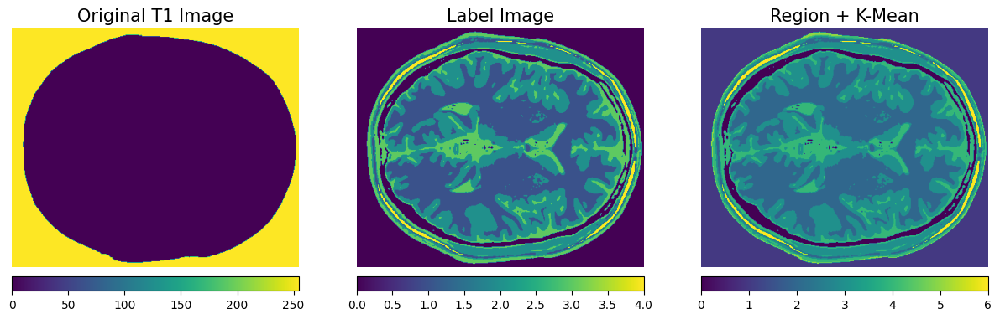

In [76]:
segmented_image1 = region_growing(T1[:,:,0], (50, 50), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)

show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')
# plt.imshow(join_segmentations(segmented_image1, segmented_image2))


# plt.imshow(join_segmentations(segmented_image2, segmented_image1))

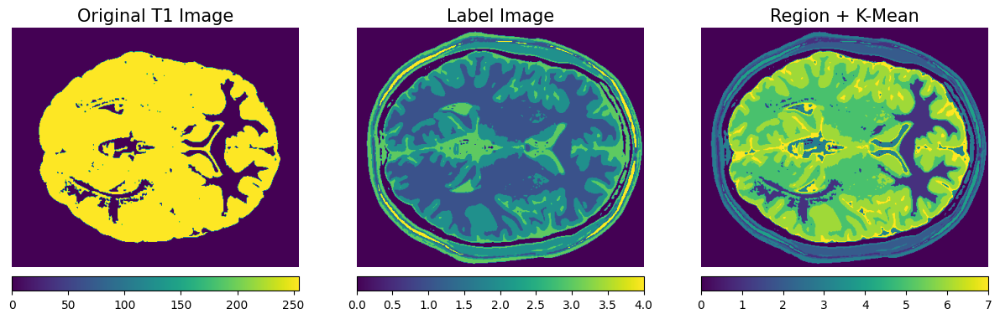

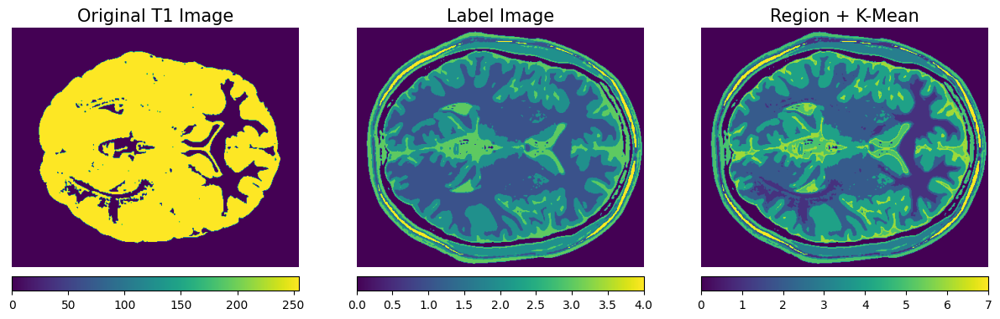

In [77]:

segmented_image1 = region_growing(T1[:,:,0], (150, 150), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

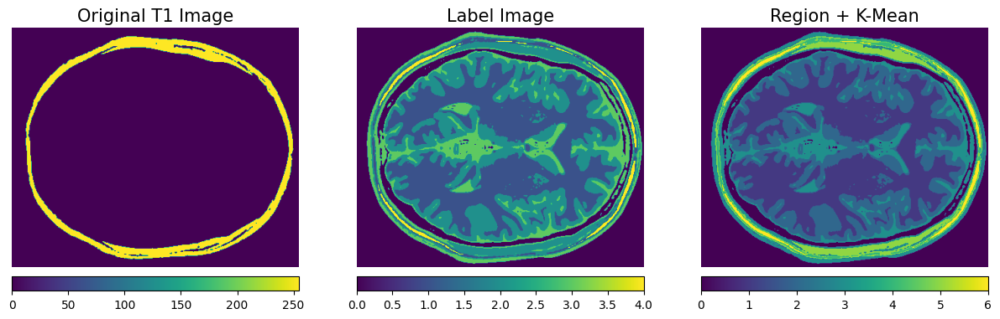

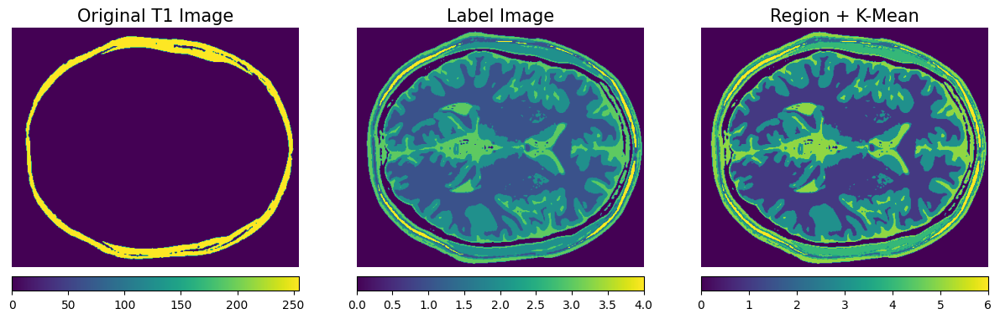

In [83]:
segmented_image1 = region_growing(T1[:,:,0], (70, 70), 100)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

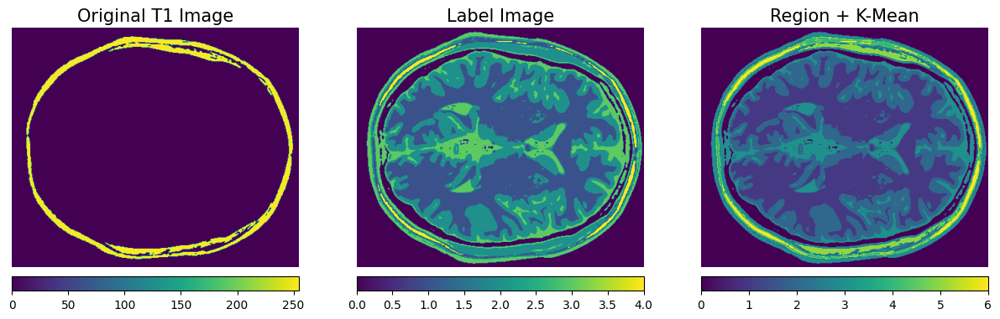

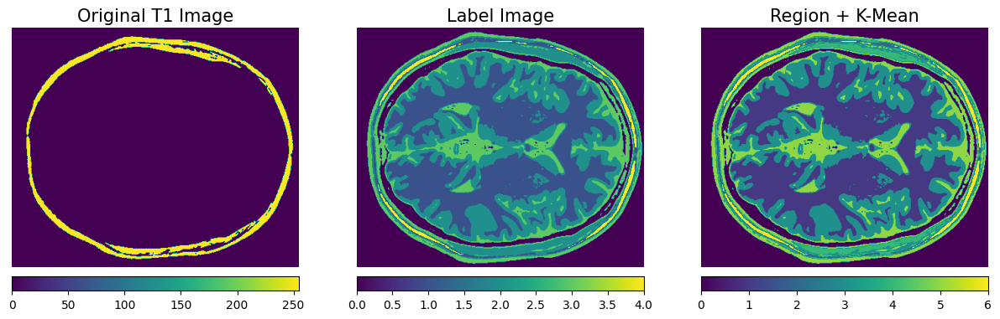

In [89]:
segmented_image1 = region_growing(T1[:,:,0], (70, 70), 90)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

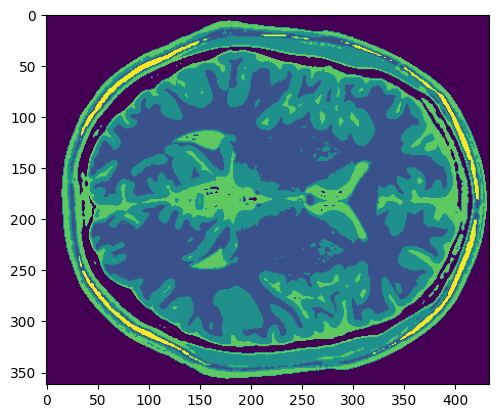

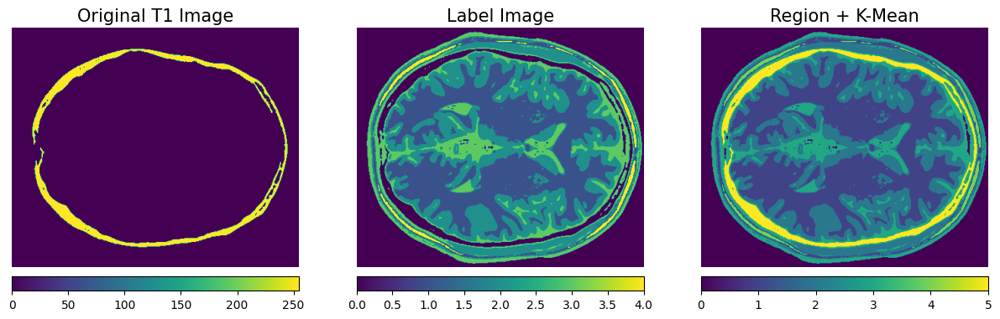

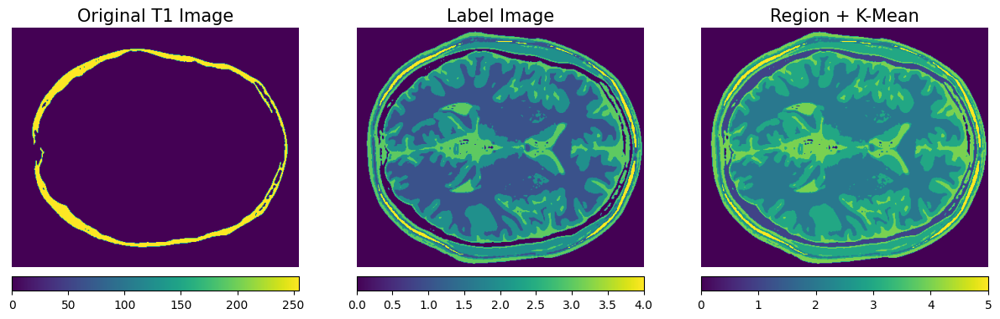

In [95]:
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
segmented_image1 = region_growing(segmented_image2, (80, 80), 70)

plt.imshow(segmented_image2)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

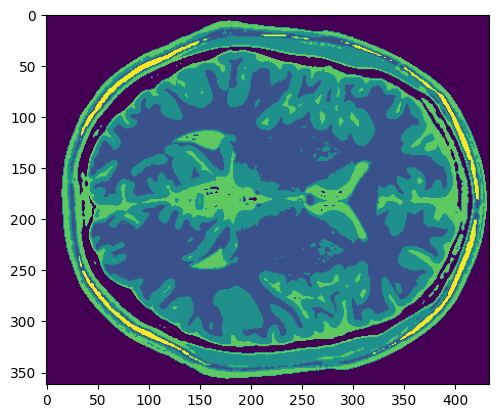

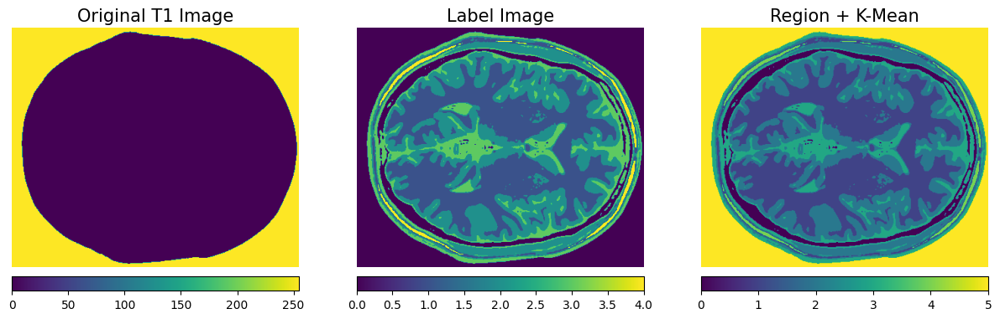

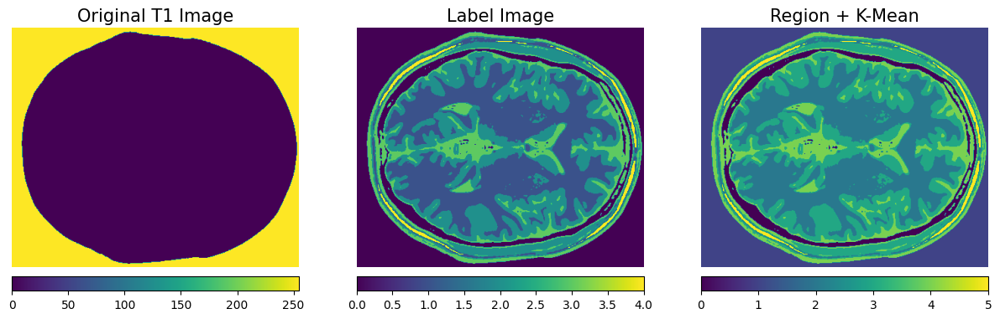

In [96]:
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
segmented_image1 = region_growing(segmented_image2, (50, 50), 70)

plt.imshow(segmented_image2)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

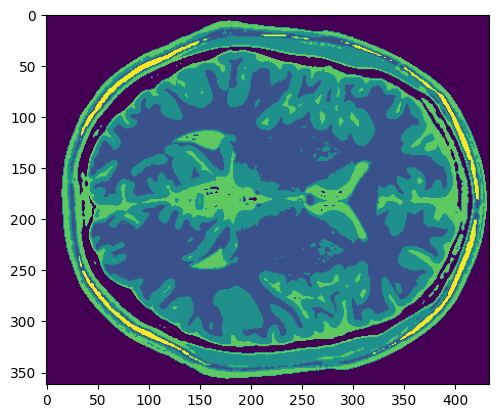

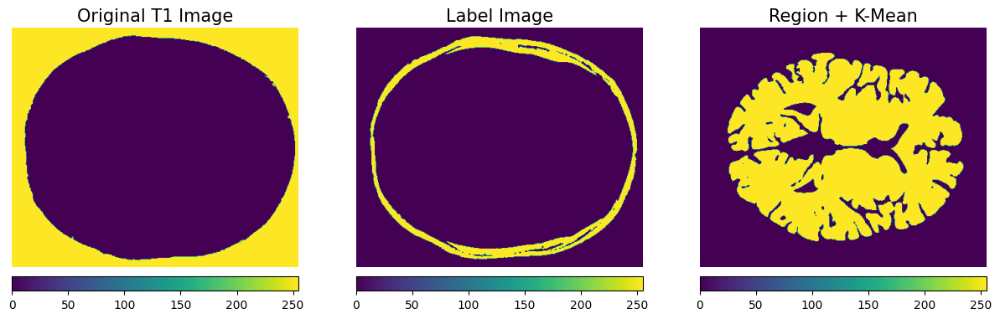

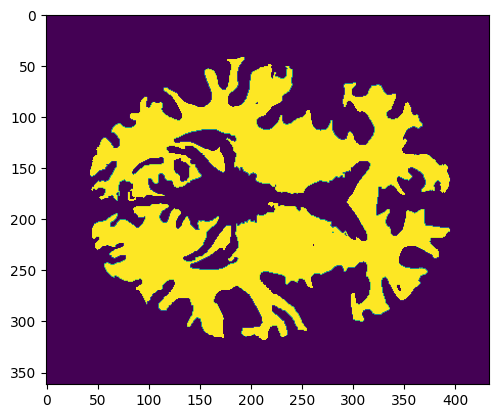

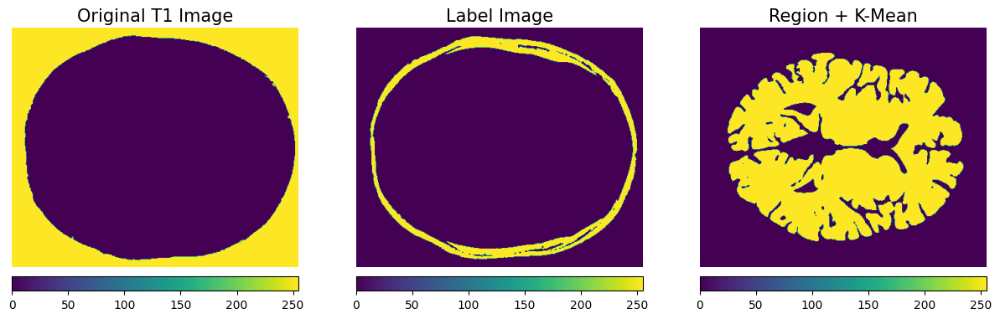

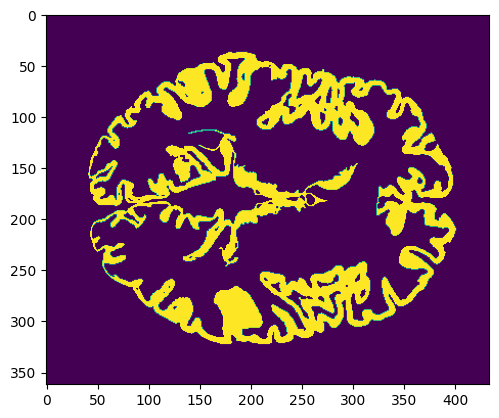

In [136]:
segmented_image1 = region_growing(T1[:,:,0], (50, 50), 70)
segmented_image2 = region_growing(T1[:,:,0], (70, 70), 100)
segmented_image3 = region_growing(T1[:,:,0], (100, 100), 50)
segmented_image5 = region_growing(T1[:,:,0], (120, 120), 30)
segmented_image6 = region_growing(T1[:,:,0], (150, 150), 20)
segmented_image4 = kmeans_segmentation(T1[:,:,0], 5)

plt.imshow(segmented_image4)
show_compared_images(segmented_image1, segmented_image2, segmented_image3,'Region + K-Mean')
plt.imshow(segmented_image5)
show_compared_images(segmented_image1, segmented_image2, segmented_image3,'Region + K-Mean')
plt.imshow(segmented_image6)

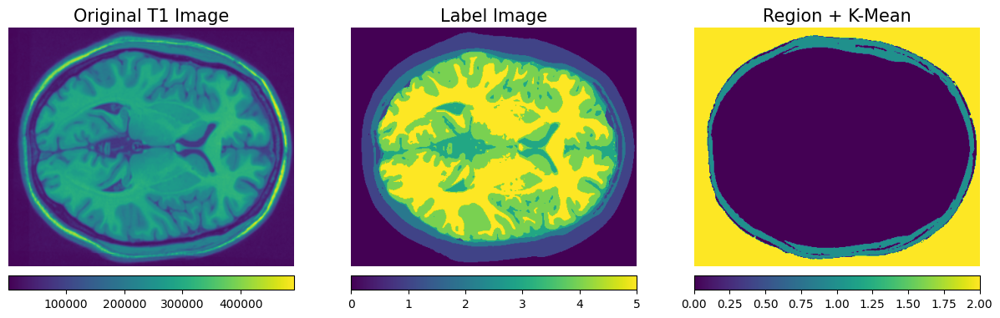

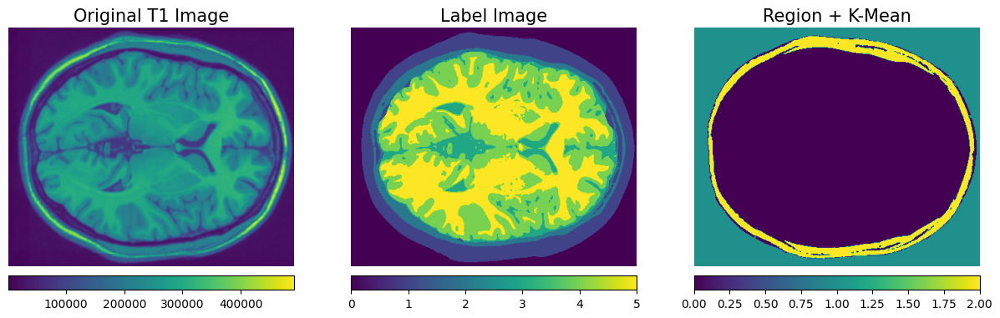

In [112]:
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

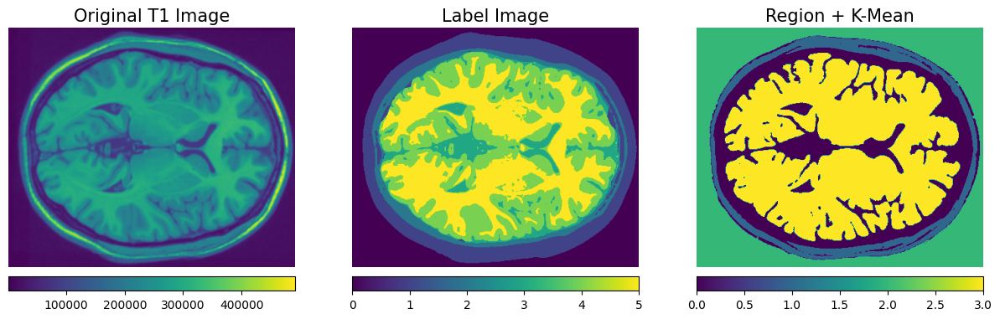

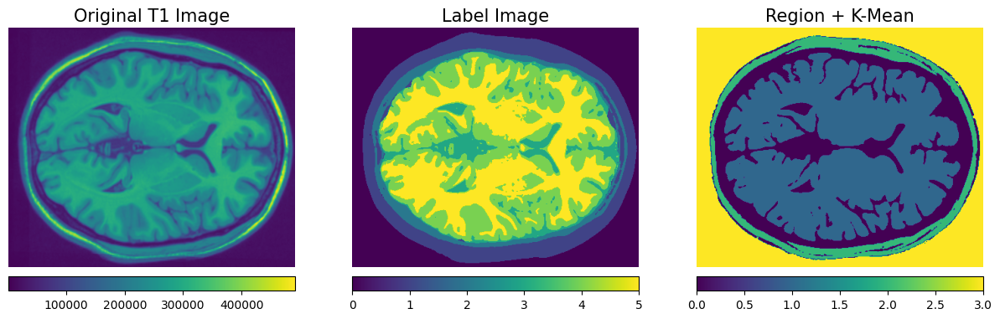

In [113]:
join1 = join_segmentations(segmented_image1, segmented_image2)
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image3, join1),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1, segmented_image3),'Region + K-Mean')

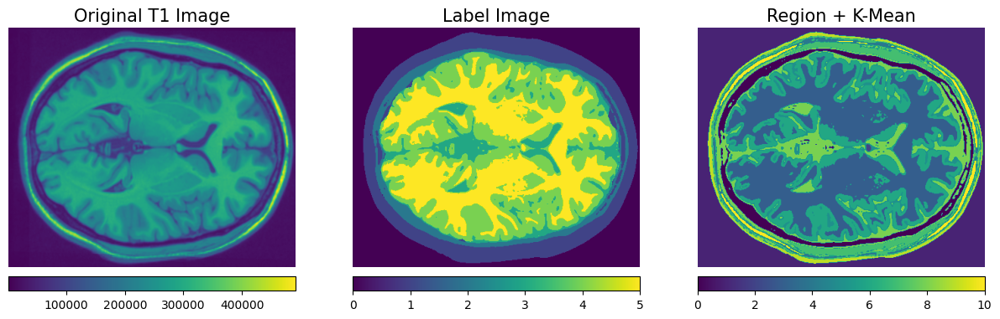

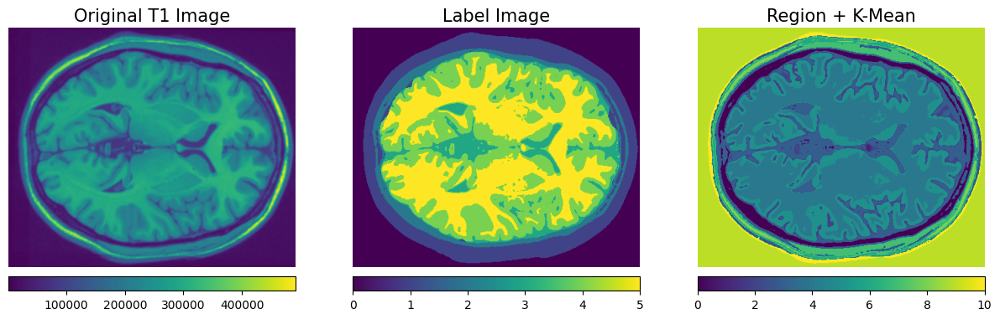

In [115]:
join2 = join_segmentations(join1, segmented_image3)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image4, join2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join2, segmented_image4),'Region + K-Mean')

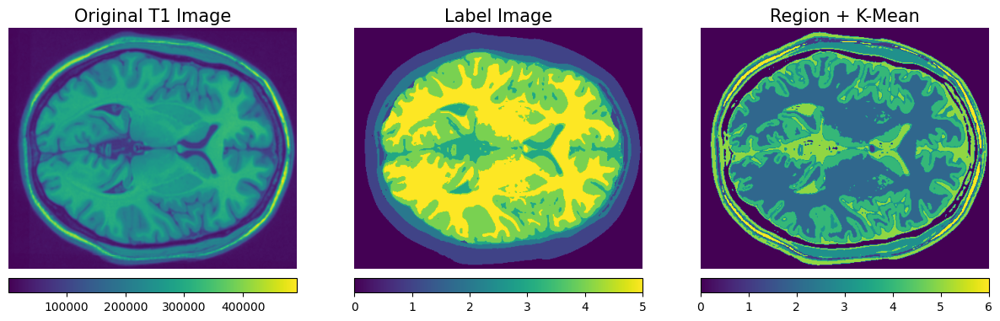

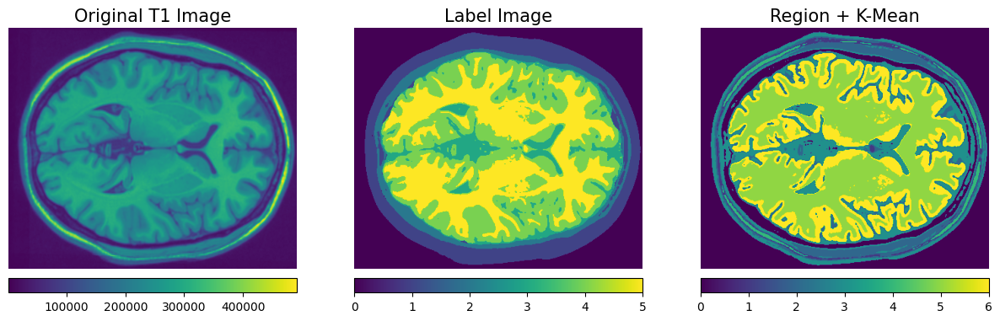

In [116]:


show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image4, segmented_image3),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image3, segmented_image4),'Region + K-Mean')

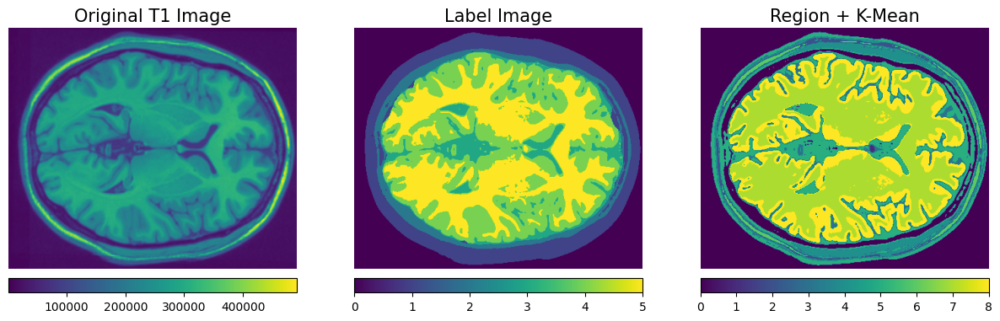

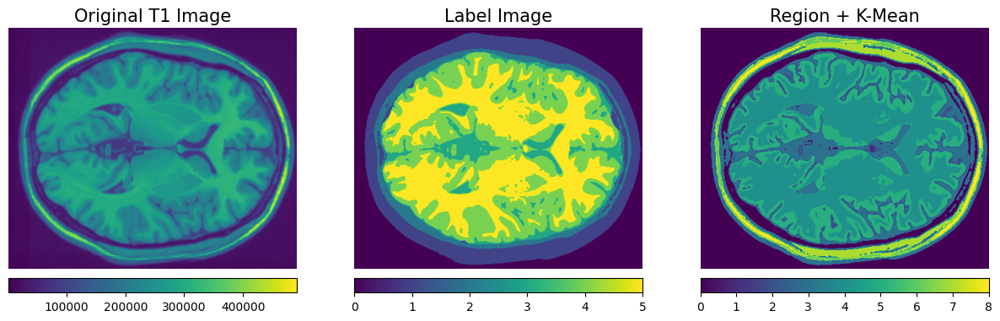

In [117]:
join1_1 = join_segmentations(segmented_image3, segmented_image4)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1_1, segmented_image2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image2, join1_1),'Region + K-Mean')

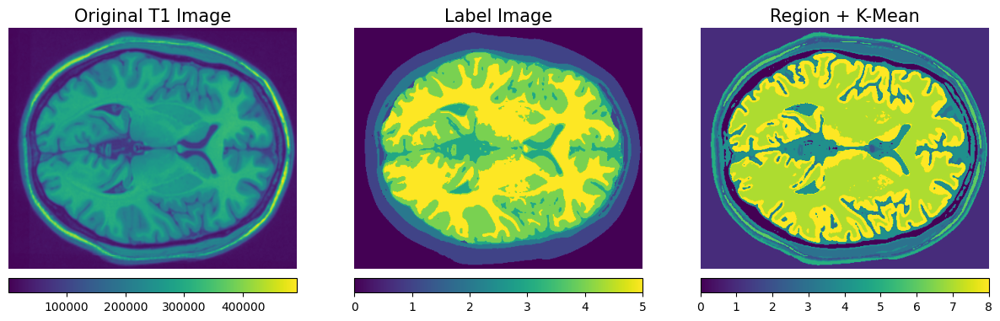

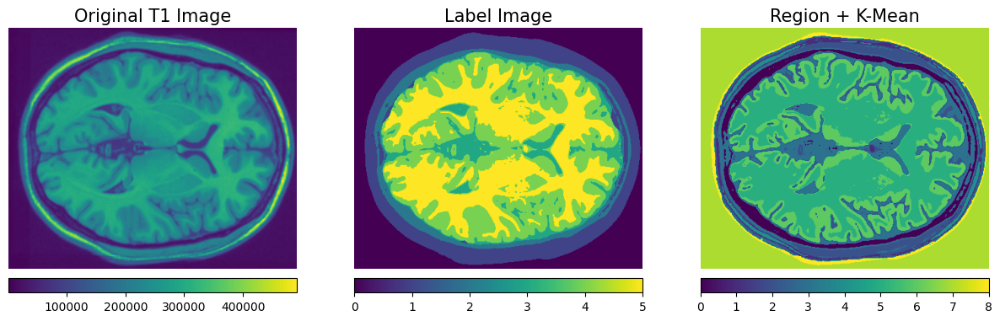

In [118]:
join1_2 = join_segmentations(join1_1, segmented_image3)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1_2, segmented_image1),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image1, join1_2),'Region + K-Mean')

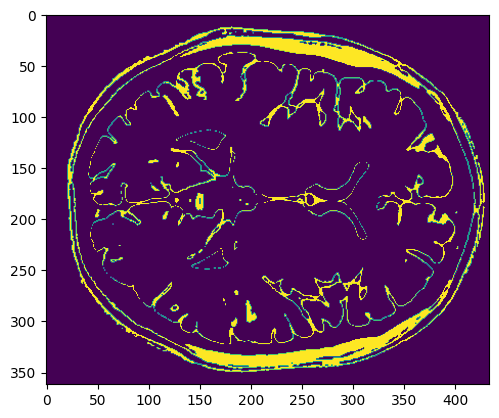

In [120]:
plt.imshow(join1_2[:,:]==2)

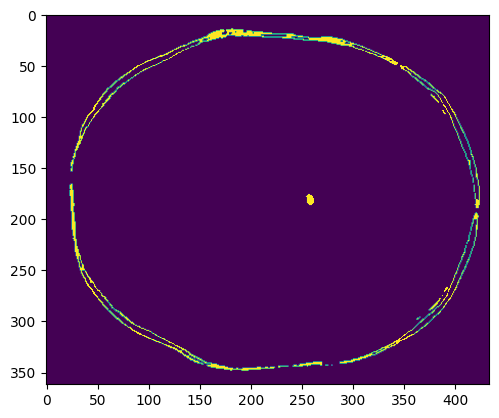

In [121]:
plt.imshow(join1_2[:,:]==1)

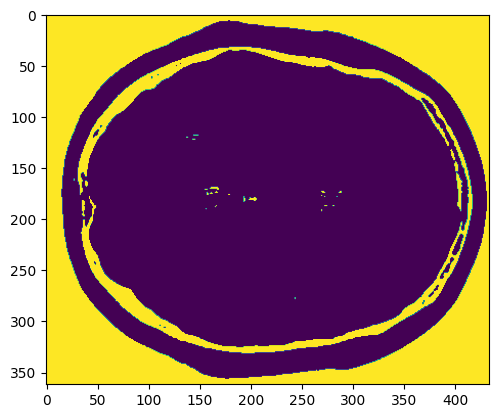

In [122]:
plt.imshow(join1_2[:,:]==0)

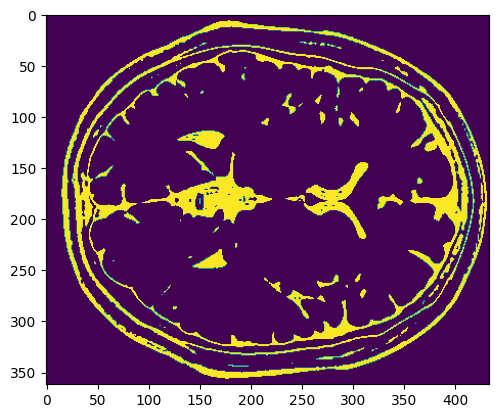

In [123]:
plt.imshow(join1_2[:,:]==3)

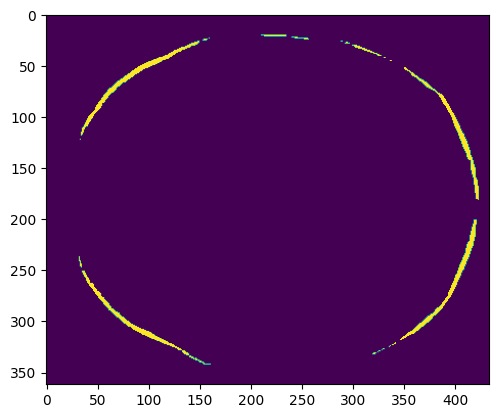

In [124]:
plt.imshow(join1_2[:,:]==4)

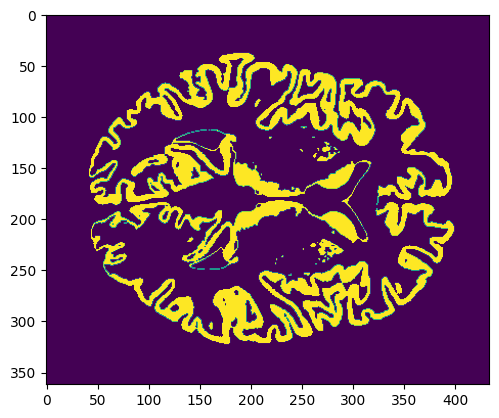

In [128]:
plt.imshow(join1_2[:,:]==6)

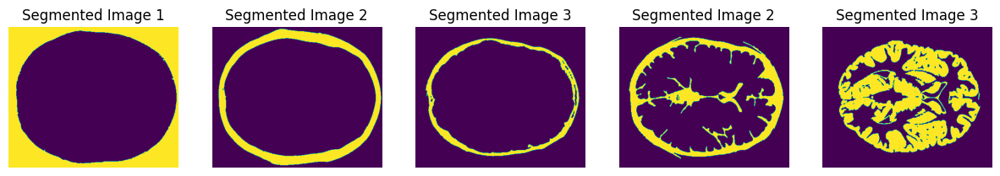

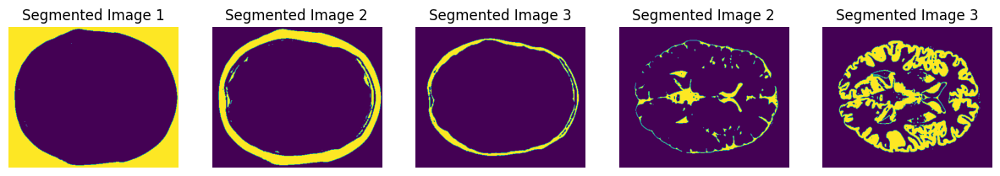

In [244]:

segmented_image1 = region_growing(T1[:,:,0], (50, 50), 70)
segmented_image2 = region_growing(T1[:,:,0], (70, 70), 150)
segmented_image3 = region_growing(T1[:,:,0], (80, 80), 33)
segmented_image4 = region_growing(T1[:,:,0], (180, 180), 60)
segmented_image5 = region_growing(T1[:,:,0], (160, 160), 35)
segmented_image6 = kmeans_segmentation(T1[:,:,0], 5)

# Create subplots
fig, axes = plt.subplots(1, 5, figsize=(15, 5))

# Display segmented images
axes[0].imshow(segmented_image1)
axes[0].set_title('Segmented Image 1')
axes[0].axis('off')

axes[1].imshow(segmented_image2)
axes[1].set_title('Segmented Image 2')
axes[1].axis('off')

axes[2].imshow(segmented_image3)
axes[2].set_title('Segmented Image 3')
axes[2].axis('off')

axes[3].imshow(segmented_image4)
axes[3].set_title('Segmented Image 2')
axes[3].axis('off')

axes[4].imshow(segmented_image5)
axes[4].set_title('Segmented Image 3')
axes[4].axis('off')

# Show the plot
plt.show()

fig, axes = plt.subplots(1, 5, figsize=(15, 5))

# Display segmented images
axes[0].imshow(label[:,:,0]==0)
axes[0].set_title('Segmented Image 1')
axes[0].axis('off')

axes[1].imshow(label[:,:,0]==1)
axes[1].set_title('Segmented Image 2')
axes[1].axis('off')

axes[2].imshow(label[:,:,0]==2)
axes[2].set_title('Segmented Image 3')
axes[2].axis('off')

axes[3].imshow(label[:,:,0]==3)
axes[3].set_title('Segmented Image 2')
axes[3].axis('off')

axes[4].imshow(label[:,:,0]==4)
axes[4].set_title('Segmented Image 3')
axes[4].axis('off')
plt.show()